## Import and set up

In [1]:
# import
import xarray as xr
import netCDF4
import numpy as np
import scipy
from scipy import stats
from scipy import signal
from scipy.interpolate import interp1d
import scipy.fftpack as fftpack


import matplotlib
import matplotlib.path as mpath
import matplotlib.ticker as mticker

import matplotlib.pyplot as plt
import matplotlib.patches as patches

import cartopy.crs as ccrs

from rhwhitepackages3.plotting import *
from rhwhitepackages3.waveguides_pre import *


%matplotlib inline

# resize plots
matplotlib.rcParams['figure.figsize']=(20,5)
matplotlib.rcParams.update({'font.size':14})

/arc/project/st-rwhite01-1/jupyter/RHW_py_39/lib/python3.9/site-packages/pyproj/__init__.py:89: UserWarning: pyproj unable to set database path.
  _pyproj_global_context_initialize()


In [2]:
# Set up definitions
cmap_def,cmap_wc,cmap_reds = get_colormaps()

dirin = '//scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/'
dirinraw = '/scratch/st-rwhite01-1/data_shared/ERA5/'

labels = ['a.','b.','c.','d.','e.','f.','g.','h.','i.','j.','k.','l.','m.','n.','o.','p.','q.']


In [3]:
# define functions
def fmt(x):
    s = f"{x:.0f}"
    return rf"{s}" if plt.rcParams["text.usetex"] else f"{s}"

def avg_LWA_reg(LWA_anoms,lat1,lat2,lon1,lon2):
 
    if lon1 > lon2:
        LWA_reg = xr.concat([LWA_anoms.sel(longitude=slice(lon1,360)),LWA_anoms.sel(longitude=slice(0,lon2))],
                                dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                dim=['longitude'])
    else:
        LWA_reg = LWA_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                        dim=['longitude'])

    coslat = np.cos(np.deg2rad(LWA_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    LWA_reg = (LWA_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')
    
    LWA_reg_seas = {}

    for seas,data in LWA_reg.groupby('time.season'):
        LWA_reg_seas[seas] = data
        
    LWA_reg_seas['ANN'] = LWA_reg
    
    return(LWA_reg_seas)

def avg_QSW_reg(QSW_anoms,lat1,lat2,lon1,lon2):
 
    if lon1 > lon2:
        QSW_reg = xr.concat([QSW_anoms.sel(longitude=slice(lon1,360)),QSW_anoms.sel(longitude=slice(0,lon2))],
                                dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                dim=['longitude'])
    else:
        QSW_reg = QSW_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat2,lat1)).mean(
                        dim=['longitude'])

    coslat = np.cos(np.deg2rad(QSW_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    QSW_reg = (QSW_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')
    
    QSW_reg_seas = {}

    for seas,data in QSW_reg.groupby('time.season'):
        QSW_reg_seas[seas] = data
        
    QSW_reg_seas['ANN'] = QSW_reg
    
    return(QSW_reg_seas)

def avg_WGmap_reg(WG_anoms,lat1,lat2,lon1,lon2):

    if lon1 > lon2:
        WG_reg = xr.concat([WG_anoms.sel(longitude=slice(lon1,360)),WG_anoms.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_reg = WG_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])

    coslat = np.cos(np.deg2rad(WG_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    WG_reg = (WG_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')

    WG_reg_seas = {}

    for seas,data in WG_reg.groupby('time.season'):
        WG_reg_seas[seas] = data

    WG_reg_seas['ANN'] = WG_reg
        
    return(WG_reg_seas)

def avg_PVWGmap_reg(WG_anoms,lat1,lat2,lon1,lon2):

    if lon1 > 180: lon1 = lon1 - 360
    if lon2 > 180: lon2 = lon2 - 360
    
    # select region
    
    if lon1 > lon2:
        WG_reg = xr.concat([WG_anoms.sel(longitude=slice(lon1,180)),WG_anoms.sel(longitude=slice(-180,lon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['longitude'])
    else:
        WG_reg = WG_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['longitude'])
    coslat = np.cos(np.deg2rad(WG_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    WG_reg = (WG_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')

    WG_reg_seas = {}
    
    for seas,data in WG_reg.groupby('time.season'):
        WG_reg_seas[seas] = data

    WG_reg_seas['ANN'] = WG_reg
        
    return(WG_reg_seas)

def avg_PVWGmap_reg_360(WG_anoms,lat1,lat2,lon1,lon2):
    # select region
    
    if lon1 > lon2:
        WG_reg = xr.concat([WG_anoms.sel(longitude=slice(lon1,360)),WG_anoms.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['longitude'])
    else:
        WG_reg = WG_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['longitude'])
    coslat = np.cos(np.deg2rad(WG_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    WG_reg = (WG_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')

    WG_reg_seas = {}
    
    for seas,data in WG_reg.groupby('time.season'):
        WG_reg_seas[seas] = data

    WG_reg_seas['ANN'] = WG_reg
        
    return(WG_reg_seas)

In [ ]:
def fourier_wind_here(infile,indata,nlons,peak_freq,ndegs=360):
    X_fft = fftpack.fft(indata)

    f_s = nlons
    freqs = fftpack.fftfreq(len(indata)) * f_s
    t = np.linspace(0, ndegs, f_s, endpoint=False)

    filt_fft = X_fft.copy()
    filt_fft[np.abs(freqs) > peak_freq] = 0
    filtered_sig = fftpack.ifft(filt_fft)

    return(filtered_sig,t)

## Read in data

In [4]:
# Read in PV waveguides
PVwgs = {}
PVwgs['DJF'] = {}
PVwgs['DJF']['NH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Zonalized/waveguide_era5_DJF_NH.nc').sel(latitude=slice(85,10))
PVwgs['DJF']['SH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Zonalized/waveguide_era5_DJF_SH.nc').sel(latitude=slice(-10,-85))

PVwgs['JJA'] = {}
PVwgs['JJA']['NH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Zonalized/waveguide_era5_JJA_NH.nc').sel(latitude=slice(85,10))
PVwgs['JJA']['SH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Zonalized/waveguide_era5_JJA_SH.nc').sel(latitude=slice(-10,-85))

In [5]:
# Read in Fourier transformed PV waveguides
PVFwgs = {}
PVFwgs['DJF'] = {}
PVFwgs['DJF']['NH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Fourier_decomp/waveguide_filtered_pv_era5_DJF_79_22.nc').sel(latitude=slice(85,10))
PVFwgs['DJF']['SH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Fourier_decomp/waveguide_filtered_pv_era5_DJF_79_22.nc').sel(latitude=slice(-10,-85))

PVFwgs['JJA'] = {}
PVFwgs['JJA']['NH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Fourier_decomp/waveguide_filtered_pv_era5_JJA_79_22.nc').sel(latitude=slice(85,10))
PVFwgs['JJA']['SH'] = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'Fourier_decomp/waveguide_filtered_pv_era5_JJA_79_22.nc').sel(latitude=slice(-10,-85))

## Plot climatologies of Ks and grad(ln(PV)) - Fig. 2

In [6]:
# Calculate Ks Climatologies
Ksfile = '/scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/Ks/Ks_ERA5_NH_u300_dailymean_filtered_1979-2022_tf15_zfnt2_1x1.nc'
Ksfile2 = '/scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/Ks/Ks_ERA5_SH_u300_dailymean_filtered_1979-2022_tf15_zfnt2_1x1.nc'

# NH

seasise = {}
seasise['DJF'] = {}
seasise['DJF']['NH'] = 320
seasise['DJF']['SH'] = 345

seasise['JJA'] = {}
seasise['JJA']['NH'] = 340
seasise['JJA']['SH'] = 325

KsWG_median = {}
U_mean = {}

with xr.open_dataset(Ksfile) as ERA5wg_NH:
    with xr.open_dataset(Ksfile2) as ERA5wg_SH:
        # Select only JJA and take mean
        n = 1
        for iseas in ['JJA','DJF']:
            KsWG_median[iseas] = {}
            U_mean[iseas] = {}

            sel_data = ERA5wg_NH.sel(time=slice('1979','2022'))
            sel_data2 = xr.where(np.isnan(sel_data.Ks),0,sel_data.Ks)

            KsWG_median[iseas]['NH'] = sel_data2.groupby('time.season').median(dim='time').sel(season=iseas)
            U_mean[iseas]['NH'] = sel_data.groupby('time.season').mean(dim='time').sel(season=iseas).Ufilter
           
            sel_data = ERA5wg_SH.sel(time=slice('1979','2022'))
            sel_data2 = xr.where(np.isnan(sel_data.Ks),0,sel_data.Ks)

            KsWG_median[iseas]['SH'] = sel_data2.groupby('time.season').median(dim='time').sel(season=iseas)
            U_mean[iseas]['SH'] = sel_data.groupby('time.season').mean(dim='time').sel(season=iseas).Ufilter


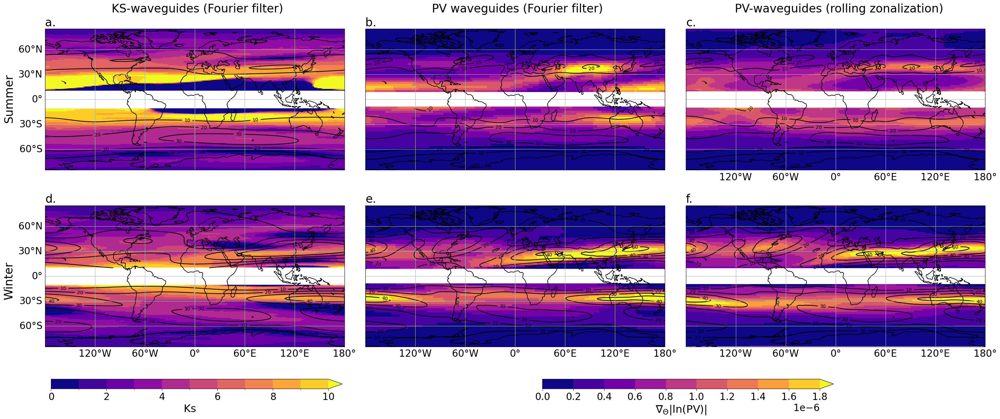

In [7]:
# Plot median climatology of daily Ks at 300hPa with mean PV gradient for Fourier-transform and zonalized PV 
fig = plt.figure(figsize=(35,14))
matplotlib.rcParams.update({'font.size':20})

# NH
seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

seasons = {}
seasons['Summer'] = {}
seasons['Summer']['NH'] = 'JJA'
seasons['Summer']['SH'] = 'DJF'
seasons['Winter'] = {}
seasons['Winter']['SH'] = 'JJA'
seasons['Winter']['NH'] = 'DJF'

datain = xr.open_dataset(dirinraw + '/u/ERA5_u_850_250_dailymean_1degree_1979-2022.nc').sel(level=300).u
U_ERA5_seas_NF = datain.groupby('time.season').mean(dim='time')
    

# Select only JJA and take mean
n = 1
for iseas in ['Summer','Winter']:

    # Plot data
    ax = plt.subplot(2,3,n,projection=ccrs.PlateCarree()); n+=1
    ax.coastlines(color='k')
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    if n == 2:
        gl.bottom_labels = False
    gl.right_labels = False

    toplot = KsWG_median[seasons[iseas]['NH']]['NH']
    toplot = xr.where(toplot.latitude > 10,toplot,np.nan)
    toplot.plot(cmap = 'plasma',levels=np.arange(0,10.1,1),extend='max',
                                 transform=ccrs.PlateCarree(),add_colorbar=False)

    CS = U_mean[seasons[iseas]['NH']]['NH'].plot.contour(colors='k',levels=[10,20,30,40,60],transform=ccrs.PlateCarree())

    toplot = KsWG_median[seasons[iseas]['SH']]['SH']
    toplot = xr.where(toplot.latitude < -10,toplot,np.nan)
    plot1 = toplot.plot(cmap = 'plasma',levels=np.arange(0,10.1,1),extend='max',
                                 transform=ccrs.PlateCarree(),add_colorbar=False)

    CS = U_mean[seasons[iseas]['SH']]['SH'].plot.contour(colors='k',levels=[10,20,30,40,60],transform=ccrs.PlateCarree())
    ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)
    plt.ylim(-85,85)

    plt.title('')
    plt.title(labels[n-2],loc='left')

    if n == 2:
        plt.text(-230,-25,'Summer',rotation = 90, fontsize=24) 
    if n == 5:
        plt.text(-230,-25,'Winter',rotation = 90, fontsize=24)        
    plt.ylim(-85,85)
    if n == 2:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  
            
    # PV-waveguides Fourier filter
    # Plot data
    ax = plt.subplot(2,3,n,projection=ccrs.PlateCarree()); n+=1
    ax.coastlines(color='k')
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    if n == 3:
        gl.bottom_labels = False
    gl.right_labels = False
    gl.left_labels = False

    for hemi in ['NH','SH']:
        
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)

        
        sel_data = PVFwgs[seasons[iseas][hemi]][hemi].sel(time=slice('1979','2022')).sel(isentrope=seasise[iseas])
        sel_data2 = xr.where(np.isnan(sel_data.ngl_pv_filtered),0,sel_data.ngl_pv_filtered)

        sel_datamean = sel_data2.groupby('time.season').mean(dim='time').sel(season=[seasons[iseas][hemi]])

        plot2 = sel_datamean.plot(cmap = 'plasma',levels=np.arange(0,2E-6,0.2E-6),extend='max',
                                 transform=ccrs.PlateCarree(),add_colorbar=False)
        CS = Uplot.plot.contour(colors='k',levels=[10,20,30,40,60],transform=ccrs.PlateCarree())
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)

    plt.ylim(-85,85)

    plt.title('')
    plt.title(labels[n-2],loc='left')

    if n == 3:
        plt.text(-100,105,'PV waveguides (Fourier filter)',fontsize=24)  
        
        
    # PV waveguides
    # Plot data
    ax = plt.subplot(2,3,n,projection=ccrs.PlateCarree()); n+=1
    ax.coastlines(color='k')
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    if n == 3:
        gl.bottom_labels = False
    gl.right_labels = False
    gl.left_labels = False

    for hemi in ['NH','SH']:
        
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)

        sel_data = PVwgs[seasons[iseas][hemi]][hemi].sel(time=slice('1979','2022')).sel(isentrope=seasise[iseas])
        sel_data2 = xr.where(np.isnan(sel_data.ngl_pv_rz),0,sel_data.ngl_pv_rz)

        sel_datamean = sel_data2.groupby('time.season').mean(dim='time').sel(season=[seasons[iseas][hemi]])

        plot2 = sel_datamean.plot(cmap = 'plasma',levels=np.arange(0,2E-6,0.2E-6),extend='max',
                                 transform=ccrs.PlateCarree(),add_colorbar=False)
        
        CS = Uplot.plot.contour(colors='k',levels=[10,20,30,40,60],transform=ccrs.PlateCarree())
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)

    plt.ylim(-85,85)

    plt.title('')
    plt.title(labels[n-2],loc='left')

    if n == 4:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.13, 0.08, 0.24, 0.02])
cb = fig.colorbar(plot1, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Ks', size=22)
  
cbar_ax = fig.add_axes([0.535, 0.08, 0.24, 0.02])
cb = fig.colorbar(plot2, cax=cbar_ax,orientation='horizontal')
cb.set_label(label=r'$\nabla_{\Theta}$|ln(PV)|', size=22)
    

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=-0.1)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/Ks_median_mask_PVgrad_clim_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/Ks_median_mask_PVgrad_clim_Dec12.png',dpi=300)

plt.show()

## Plot waveguide frequency climatology - Fig. 3

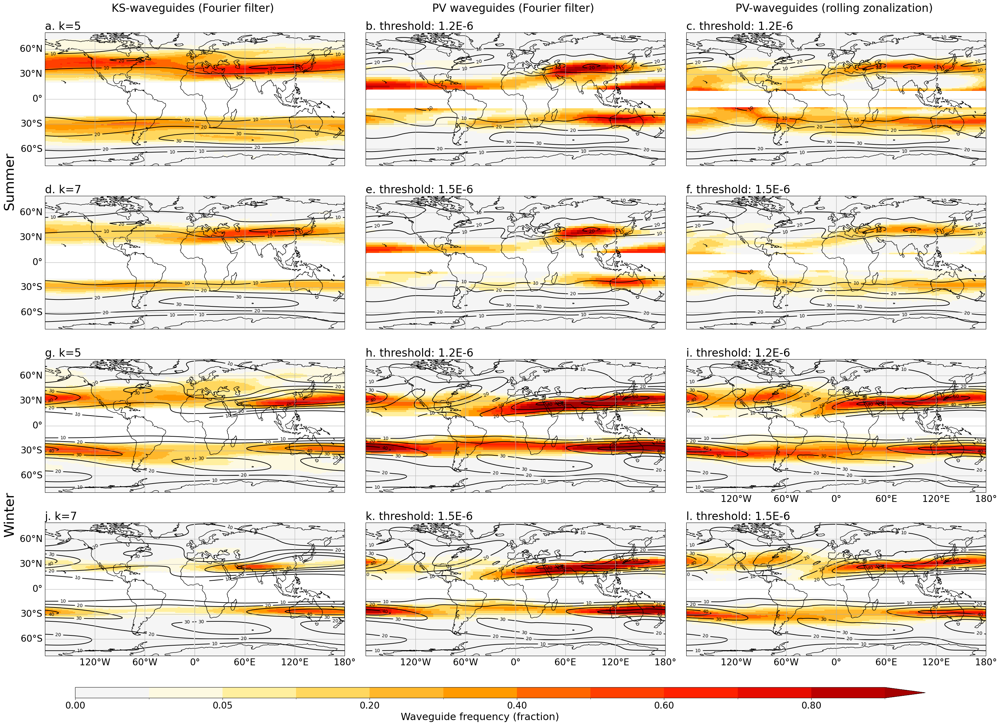

In [10]:
# Calculate and plot climatological frequency, Ks, PVF, PV - summer/winter
# Define isentropes for different seasons and hemispheres
seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

seasons = {}
seasons['Summer'] = {}
seasons['Summer']['NH'] = 'JJA'
seasons['Summer']['SH'] = 'DJF'
seasons['Winter'] = {}
seasons['Winter']['SH'] = 'JJA'
seasons['Winter']['NH'] = 'DJF'



fig = plt.figure(figsize=(37,26))
matplotlib.rcParams.update({'font.size':20})

timefilter = 15
wavelfilter = 2

WGmap_ERA5_seas = {}
U_ERA5_seas = {}

for hemi in ['NH','SH']:
    filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
    WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc')

    datain = WG_ERA5.sel(time=slice('1980','2022'))

    # get frequency
    datain_freq = np.where(datain.WG_map>0,1,0)

    datain_freq = xr.DataArray(datain_freq,
                                 dims=('time','k','latitude','longitude'),
                                 coords={'time':datain.time,
                                                             'k':datain.k,
                                                             'latitude':datain.latitude,
                                                             'longitude':datain.longitude})


    WGmap_ERA5_seas[hemi] = datain_freq.groupby('time.season').mean(dim='time')


    Ufilename = 'ERA5_' + hemi + '_u300_dailymean_filtered_1979-2022'
    U_ERA5 = xr.open_dataset(dirin + 'Ks/' + Ufilename + '_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_1x1.nc')
    
    U_ERA5_seas[hemi] = U_ERA5.groupby('time.season').mean(dim='time')
    
    
datain = xr.open_dataset(dirinraw + '/u/ERA5_u_850_250_dailymean_1degree_1979-2022.nc').sel(level=300).u
U_ERA5_seas_NF = datain.groupby('time.season').mean(dim='time')
    
    
n=1

for iseas in ['Summer','Winter']:
    for ik in [5,7]:
        ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree()); n+=3
        ax.coastlines(color='k')

        gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
        gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
        gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
        gl.top_labels = False
        gl.right_labels = False
        if n<12:
            gl.bottom_labels = False

        for hemi in ['NH','SH']:
            WGmap_ERA5_seas[hemi].sel(season=seasons[iseas][hemi]).sel(k=ik).plot(cmap=cmap_reds,transform=ccrs.PlateCarree(),
                                                    levels = [0,0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
                                                    extend='max',add_colorbar=False)
 
            CS = U_ERA5_seas[hemi].sel(season=seasons[iseas][hemi]).U_filtered.plot.contour(colors='k',transform=ccrs.PlateCarree(),
                                                              levels=[10,20,30,40,60])
 
            ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)

        plt.title(labels[n-4] + ' k=' + str(ik),loc='left')
        plt.title('')
        if n == 4:
            plt.text(-230,-130,iseas,fontsize=30,rotation = 90)
        elif n == 10:
            plt.text(-230,-130,iseas,fontsize=30,rotation = 90)
      
        plt.ylim(-80,80)
        
        if n == 4:
            plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

n=2
for iseas in ['Summer','Winter']:
    ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<12:
        gl.bottom_labels = False
        

    for hemi in ['NH','SH']:
        freq = xr.where(PVFwgs[seasons[iseas][hemi]][hemi].ngl_pv_filtered > 1.2E-6,1,0)
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            freq = xr.where(freq.latitude > 10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            freq = xr.where(freq.latitude < -10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)


        plot = freq.sel(isentrope=seasise[iseas]).mean(dim='time').plot(cmap=cmap_reds,transform=ccrs.PlateCarree(),
                                                        levels = [0,0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
                                                        extend='max',add_colorbar=False)
        
        CS = Uplot.plot.contour(colors='k',transform=ccrs.PlateCarree(),
                                            levels=[10,20,30,40,60])
 
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)

    plt.ylim(-80,80)
    plt.title(labels[n-4] + ' threshold: 1.2E-6',loc='left')
    plt.title('')
    
    if n == 5:
        plt.text(-100,105,'PV waveguides (Fourier filter)',fontsize=24)  
    
    
    ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<12:
        gl.bottom_labels = False
        

    for hemi in ['NH','SH']:
        freq = xr.where(PVFwgs[seasons[iseas][hemi]][hemi].ngl_pv_filtered > 1.5E-6,1,0)
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            freq = xr.where(freq.latitude > 10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            freq = xr.where(freq.latitude < -10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)

        plot = freq.sel(isentrope=seasise[iseas]).mean(dim='time').plot(cmap=cmap_reds,transform=ccrs.PlateCarree(),
                                                    levels = [0,0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
                                                    extend='max',add_colorbar=False)
        CS = Uplot.plot.contour(colors='k',transform=ccrs.PlateCarree(),
                                                              levels=[10,20,30,40,60])
 
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)
     
    plt.ylim(-80,80)
    plt.title(labels[n-4] + ' threshold: 1.5E-6',loc='left')
    plt.title('')
                
            
n=3
for iseas in ['Summer','Winter']:
    ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<12:
        gl.bottom_labels = False
        

    for hemi in ['NH','SH']:
        freq = xr.where(PVwgs[seasons[iseas][hemi]][hemi].ngl_pv_rz > 1.2E-6,1,0)
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            freq = xr.where(freq.latitude > 10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            freq = xr.where(freq.latitude < -10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)

        plot = freq.sel(isentrope=seasise[iseas]).mean(dim='time').plot(cmap=cmap_reds,transform=ccrs.PlateCarree(),
                                                        levels = [0,0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
                                                        extend='max',add_colorbar=False)
        CS = Uplot.plot.contour(colors='k',transform=ccrs.PlateCarree(),
                                                              levels=[10,20,30,40,60])
 
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)
     
    plt.ylim(-80,80)
    plt.title(labels[n-4] + ' threshold: 1.2E-6',loc='left')
    plt.title('')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  
    
    
    
    ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<12:
        gl.bottom_labels = False
        

    for hemi in ['NH','SH']:
        freq = xr.where(PVwgs[seasons[iseas][hemi]][hemi].ngl_pv_rz > 1.5E-6,1,0)
        Uplot = U_ERA5_seas_NF.sel(season=seasons[iseas][hemi])
        if hemi == 'NH':
            freq = xr.where(freq.latitude > 10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude > 10, Uplot, np.nan)
        elif hemi == 'SH':
            freq = xr.where(freq.latitude < -10,freq,np.nan)
            Uplot = xr.where(Uplot.latitude < -10, Uplot, np.nan)

        plot = freq.sel(isentrope=seasise[iseas]).mean(dim='time').plot(cmap=cmap_reds,transform=ccrs.PlateCarree(),
                                                        levels = [0,0.01,0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
                                                        extend='max',add_colorbar=False)
        CS = Uplot.plot.contour(colors='k',transform=ccrs.PlateCarree(),
                                                              levels=[10,20,30,40,60])
 
        ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=10)
     
    plt.ylim(-80,80)
    plt.title(labels[n-4] + ' threshold: 1.5E-6',loc='left')
    plt.title('')
    

# create common colorbar
cbar_ax = fig.add_axes([0.15, 0.08, 0.7, 0.0125])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Waveguide frequency (fraction)', size=22)


#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=-0.02)

fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/Figures/NHSH_freq_KS_PVFF_PV_clim_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/Figures/NHSH_freq_KS_PVFF_PV_clim_Dec12.png',dpi=300)


plt.show()


## Plot composites

### U wind - Figs. 4 and 5

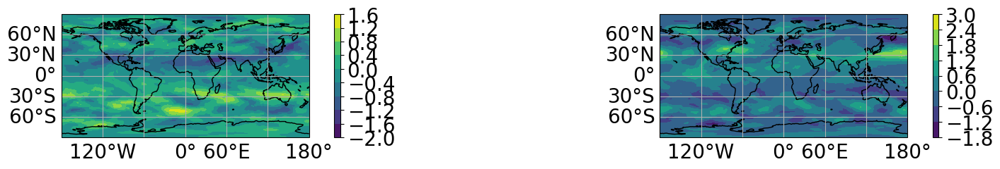

In [11]:
# Calculate bootstrapping for U300 anoms from smooth clim and plot means
# Read in U and WG anoms:
startsel = 0
skipsel = 5
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data.u[startsel::skipsel,:,:]

nbs = 500

USCanoms = {}
USCanoms_95 = {}
USCanoms_05 = {}
USCanoms_975 = {}
USCanoms_025 = {}

# For summer
for iseas in ['DJF','JJA']:
    USCanoms[iseas] = np.zeros([nbs,len(U_ERA5.latitude),len(U_ERA5.longitude)])

    for ibs in range(0,nbs):
        random_all = np.random.randint(0,len(U_ERA5_seas[iseas]),int(len(U_ERA5_seas[iseas])/10))

        USCanoms[iseas][ibs,:,:] = (U_ERA5_seas[iseas].isel(time=random_all).mean(dim='time'))
        
    USCanoms_975[iseas] = np.percentile(USCanoms[iseas],97.5,axis = 0)
    USCanoms_95[iseas] = np.percentile(USCanoms[iseas],95,axis = 0)
    USCanoms_05[iseas] = np.percentile(USCanoms[iseas],5,axis = 0)
    USCanoms_025[iseas] = np.percentile(USCanoms[iseas],2.5,axis = 0)

n=1
for iseas in ['JJA','DJF']:
    ax = plt.subplot(2,2,n,projection=ccrs.PlateCarree()); n+=1
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False

    plt.contourf(U_ERA5_seas[iseas].longitude,U_ERA5_seas[iseas].latitude,USCanoms[iseas].mean(axis=0))
    plt.colorbar()

plt.show()



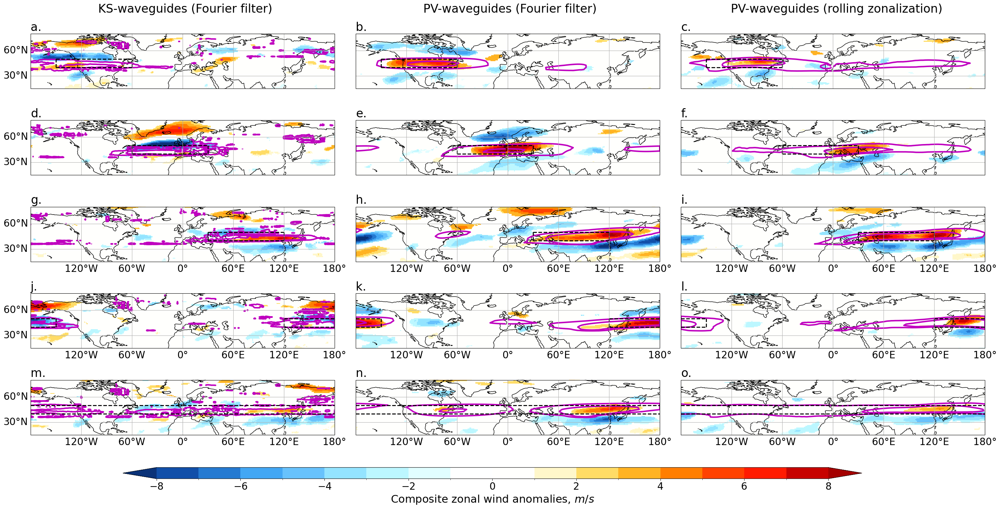

In [12]:
# Ks, PVF, PV comparison - NH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'JJA'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1.5,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,105,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite zonal wind anomalies, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

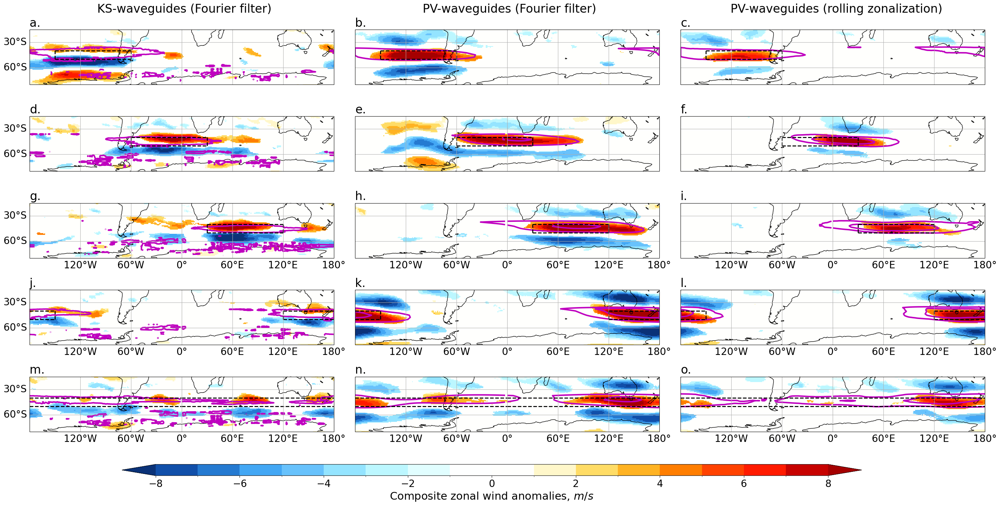

In [13]:
# Ks, PVF, PV comparison - SH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'DJF'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(-35,0)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,5,'PV-waveguides (Fourier filter)',fontsize=24)  

        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite zonal wind anomalies, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

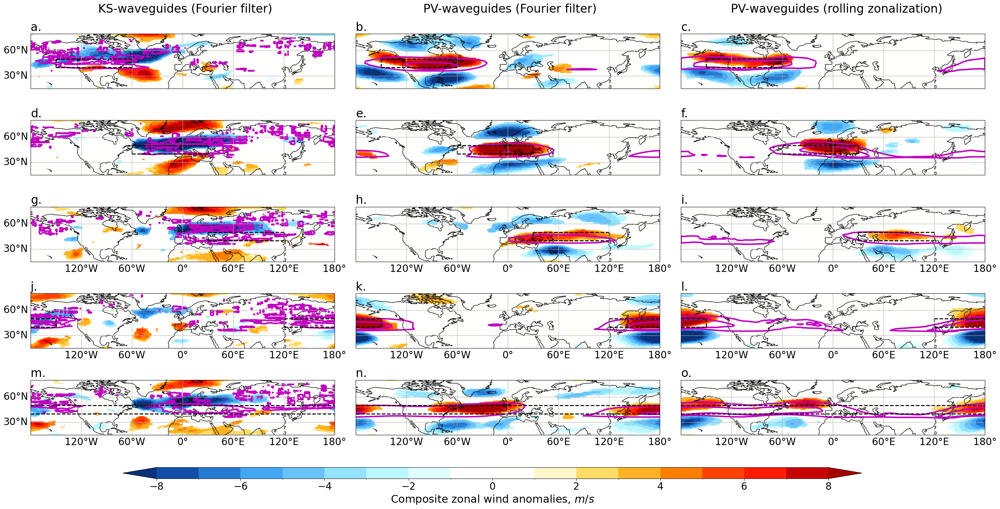

In [14]:
# Ks, PVF, PV comparison - NH winter - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'DJF'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1.5,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,105,'PV-waveguides (Fourier filter)',fontsize=24)  

        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite zonal wind anomalies, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

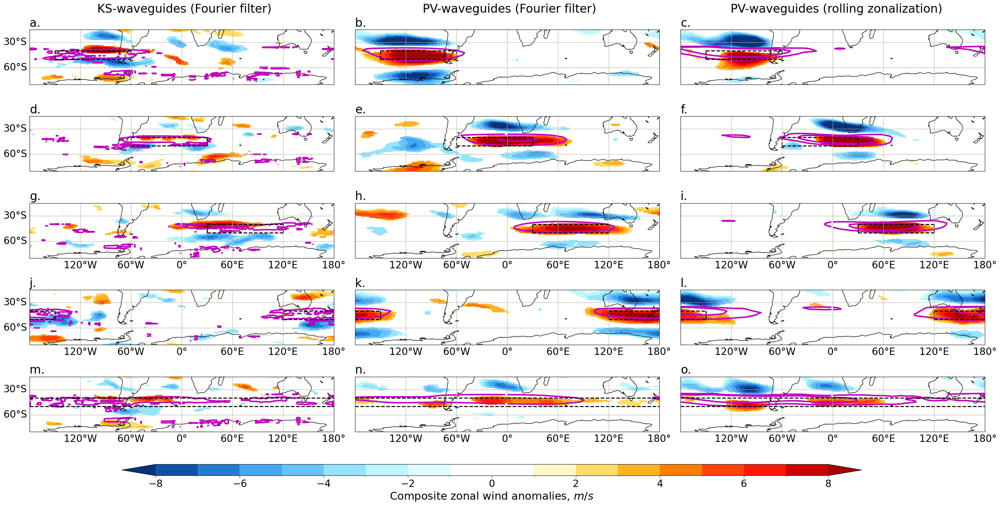

In [15]:
# Ks, PVF, PV comparison - SH winter - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'JJA'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(-35,0)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,5,'PV-waveguides (Fourier filter)',fontsize=24)  
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)

        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite zonal wind anomalies, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Uanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

#### Sensitivity to latitude

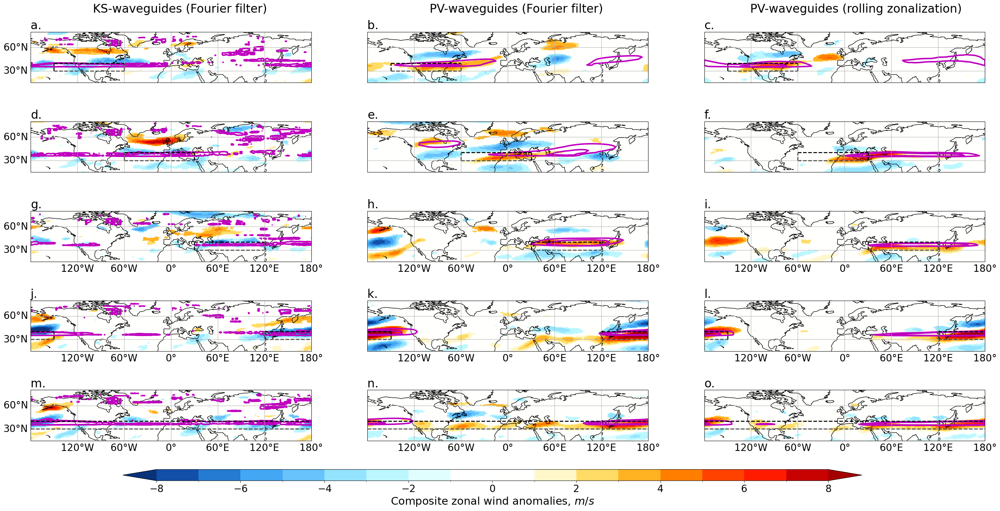

In [16]:
# Ks, PVF, PV comparison - NH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'JJA'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [30,30,30,30,30]
    reg_lats2 = [40,40,40,40,40]
elif hemi == 'SH':
    reg_lats1 = [-40,-40,-40,-40,-40]
    reg_lats2 = [-30,-30,-30,-30,-30] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1.5,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')

    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,105,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].u.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > USCanoms_975[season],
                                    diffs < USCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-8.0,8.1,1),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite zonal wind anomalies, $m/s$', size=22)

plt.show()

### Z500 composites - Figs. 6 and 7

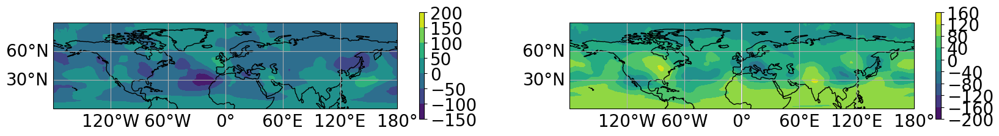

In [17]:
# Calculate bootstrapping for z500 anoms from smooth clim and plot means
# Read in U and WG anoms:
startsel = 0
skipsel = 5
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc').rename_dims(
                                                            {'lat':'latitude','lon':'longitude'})

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data.z[startsel::skipsel,:,:]

nbs = 500

ZSCanoms = {}
ZSCanoms_95 = {}
ZSCanoms_05 = {}
ZSCanoms_975 = {}
ZSCanoms_025 = {}

# For summer
for iseas in ['DJF','JJA']:
    Zclim = U_ERA5_seas[iseas].mean(dim='time')
    ZSCanoms[iseas] = np.zeros([nbs,len(U_ERA5.latitude),len(U_ERA5.longitude)])

    for ibs in range(0,nbs):
        random_all = np.random.randint(0,len(U_ERA5_seas[iseas]),int(len(U_ERA5_seas[iseas])/10))

        ZSCanoms[iseas][ibs,:,:] = (U_ERA5_seas[iseas].isel(time=random_all).mean(dim='time'))
        
    ZSCanoms_975[iseas] = np.percentile(ZSCanoms[iseas],97.5,axis = 0)
    ZSCanoms_95[iseas] = np.percentile(ZSCanoms[iseas],95,axis = 0)
    ZSCanoms_05[iseas] = np.percentile(ZSCanoms[iseas],5,axis = 0)
    ZSCanoms_025[iseas] = np.percentile(ZSCanoms[iseas],2.5,axis = 0)

n=1
for iseas in ['JJA','DJF']:
    ax = plt.subplot(2,2,n,projection=ccrs.PlateCarree()); n+=1
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False

    plt.contourf(U_ERA5_seas[iseas].longitude,U_ERA5_seas[iseas].latitude,ZSCanoms[iseas].mean(axis=0))
    plt.colorbar()

plt.show()



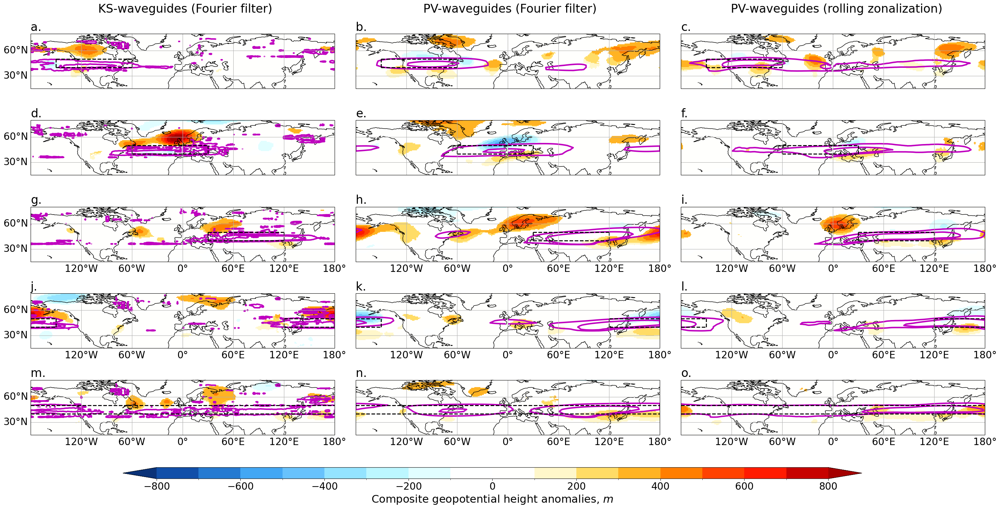

In [18]:
# Ks, PVF, PV comparison - NH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'JJA'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    
    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1.5,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,105,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot
    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)


    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite geopotential height anomalies, $m$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

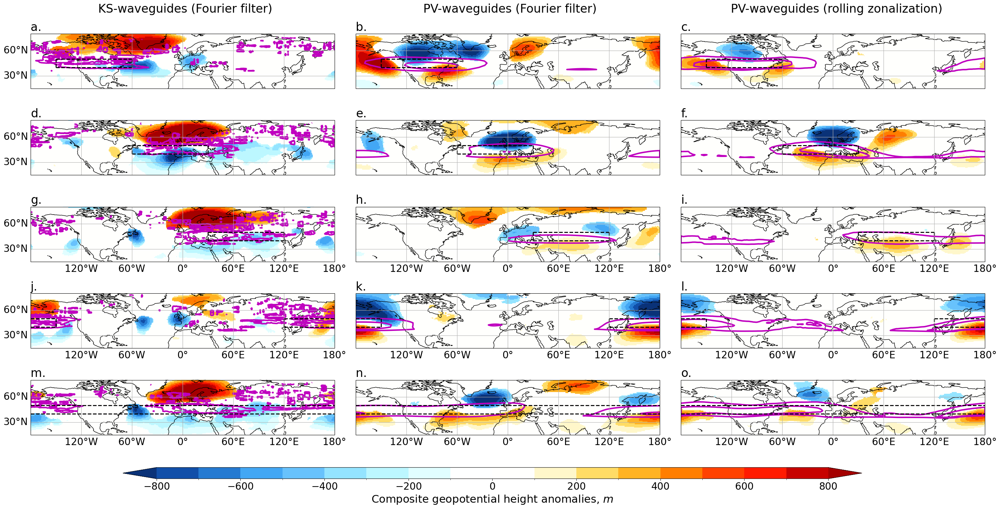

In [19]:
# Ks, PVF, PV comparison - NH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'DJF'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    
    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1.5,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')

    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,105,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)


    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(35,0)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite geopotential height anomalies, $m$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

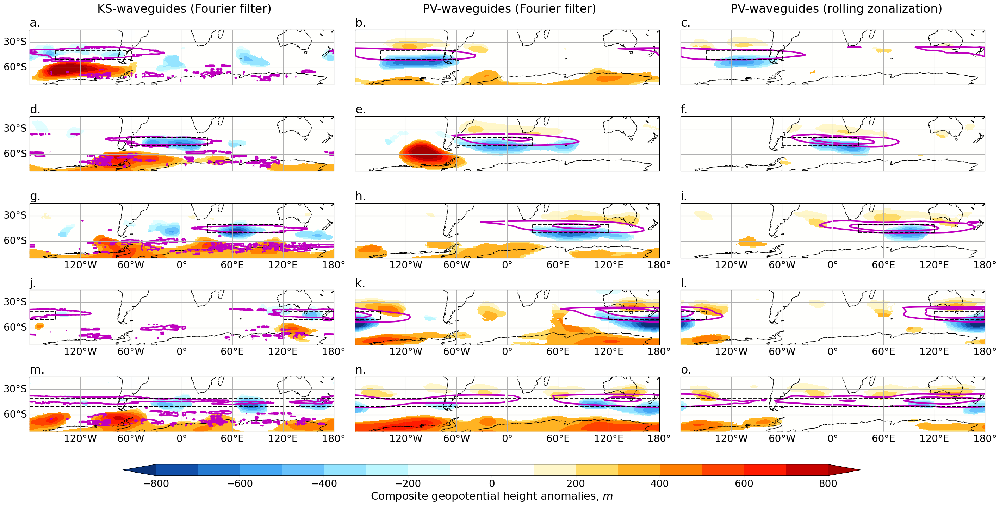

In [20]:
# Ks, PVF, PV comparison - SH summer - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'DJF'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    
    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(-35,0)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')

    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  
        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,5,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)


    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite geopotential height anomalies, $m$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

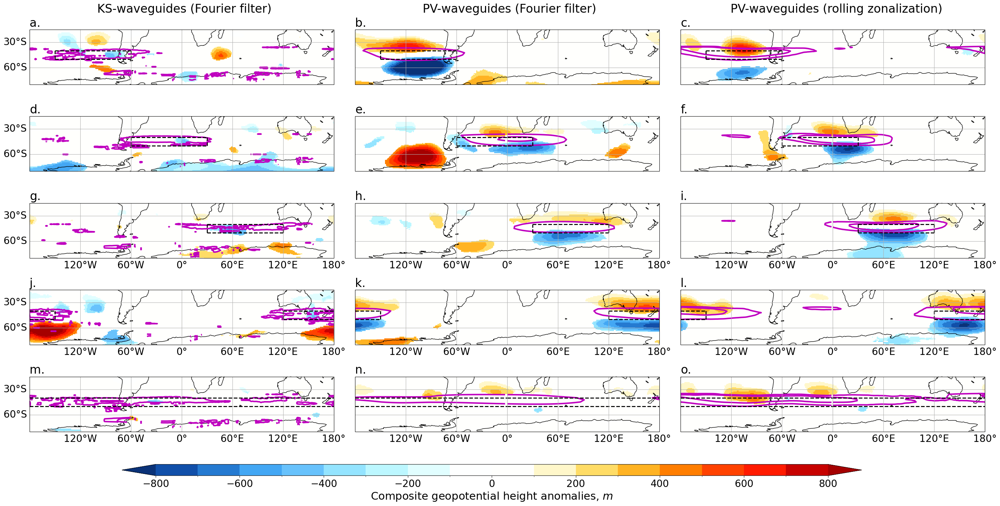

In [21]:
# Ks, PVF, PV comparison - SH winter - anoms from smooth clim
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'JJA'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 

nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
U_ERA5 = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc')
U_ERA5 = U_ERA5.sel(time=slice('1980','2022'))

U_ERA5_group = U_ERA5.groupby('time.season')

U_ERA5_seas={}
for iseas,data in U_ERA5_group:
    U_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')
    
    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(-35,0)).values[...] = 0.0

    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1,3],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  

        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region 
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 5:
        plt.text(-100,5,'PV-waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_U = U_ERA5_seas[season].z.where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_U)
    numlow = len(low_WG_U)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<11:
        gl.bottom_labels = False

    diffs = high_WG_U.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > ZSCanoms_975[season],
                                    diffs < ZSCanoms_025[season]],axis=0),diffs,0)


    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-800,800.1,100),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - WG_ERA5_seas[season].mean(dim='time'))
    toplot.sel(latitude = slice(0,-35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[1E-7,3E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite geopotential height anomalies, $m$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_Zanoms_comps_bs_PV_PVF_KS_Dec12.png',dpi=300)

plt.show()

### QSW composites - Figs. 7 and 8

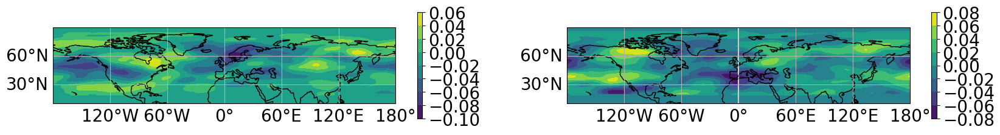

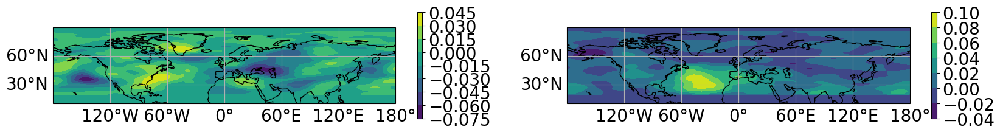

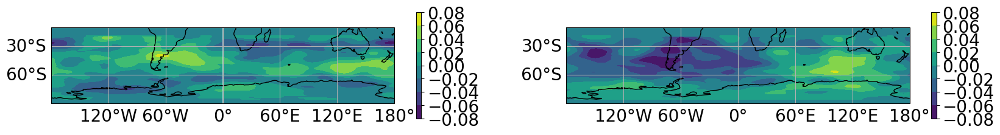

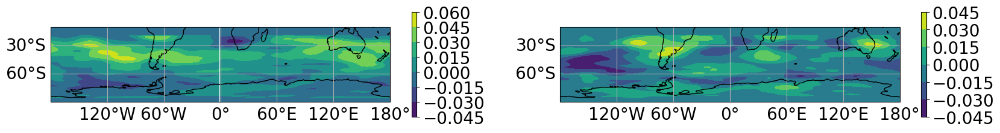

In [22]:
# Calculate bootstrapping for QSW differences and plot means

QSWdiffs = {}
QSWdiffs_95 = {}
QSWdiffs_05 = {}
QSWdiffs_975 = {}
QSWdiffs_025 = {}

startsel = 0
skipsel = 5

nbs = 500

wn_max = 15

for hemi in ['NH','SH']:
    QSWdiffs[hemi] = {}
    QSWdiffs_95[hemi] = {}
    QSWdiffs_05[hemi] = {}
    QSWdiffs_975[hemi] = {}
    QSWdiffs_025[hemi] = {}

    for wn_min in [4,6]:
        # Read in QSW anomalies
        QSWdiffs[hemi][wn_min] = {}
        QSWdiffs_95[hemi][wn_min] = {}
        QSWdiffs_05[hemi][wn_min] = {}
        QSWdiffs_975[hemi][wn_min] = {}
        QSWdiffs_025[hemi][wn_min] = {}

        QSW_ERA5 = xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_wns' + str(wn_min) + '-' + str(wn_max) + 
                                 '_1979-2022_tf' + str(timefilter) + '_1x1_anoms_from_smooth_clim.nc')
        QSW_ERA5_group = QSW_ERA5.groupby('time.season')

        QSW_ERA5_seas={}
        for iseas,data in QSW_ERA5_group:
            QSW_ERA5_seas[iseas] = data.QSW_envelope[startsel::skipsel,:,:]


        # For summer
        for iseas in ['JJA','DJF']:
            QSWdiffs[hemi][wn_min][iseas] = np.zeros([nbs,len(QSW_ERA5.latitude),len(QSW_ERA5.longitude)])

            for ibs in range(0,nbs):
                random_all = np.random.randint(0,len(QSW_ERA5_seas[iseas]),2 * int(len(QSW_ERA5_seas[iseas])/10))
                random_high = random_all[0::2] 
                random_low = random_all[1::2] 

                QSWdiffs[hemi][wn_min][iseas][ibs,:,:] = ((QSW_ERA5_seas[iseas].isel(time=random_high).mean(dim='time')) - 
                                            (QSW_ERA5_seas[iseas].isel(time=random_low).mean(dim='time')))

            QSWdiffs_975[hemi][wn_min][iseas] = np.percentile(QSWdiffs[hemi][wn_min][iseas],97.5,axis = 0)
            QSWdiffs_95[hemi][wn_min][iseas] = np.percentile(QSWdiffs[hemi][wn_min][iseas],95,axis = 0)
            QSWdiffs_05[hemi][wn_min][iseas] = np.percentile(QSWdiffs[hemi][wn_min][iseas],5,axis = 0)
            QSWdiffs_025[hemi][wn_min][iseas] = np.percentile(QSWdiffs[hemi][wn_min][iseas],2.5,axis = 0)

        n=1
        for iseas in ['JJA','DJF']:
            ax = plt.subplot(2,2,n,projection=ccrs.PlateCarree()); n+=1
            ax.coastlines(color='k')

            gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
            gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
            gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
            gl.top_labels = False
            gl.right_labels = False

            plt.contourf(QSW_ERA5_seas[iseas].longitude,QSW_ERA5_seas[iseas].latitude,QSWdiffs[hemi][wn_min][iseas].mean(axis=0))
            plt.colorbar()

        plt.show()



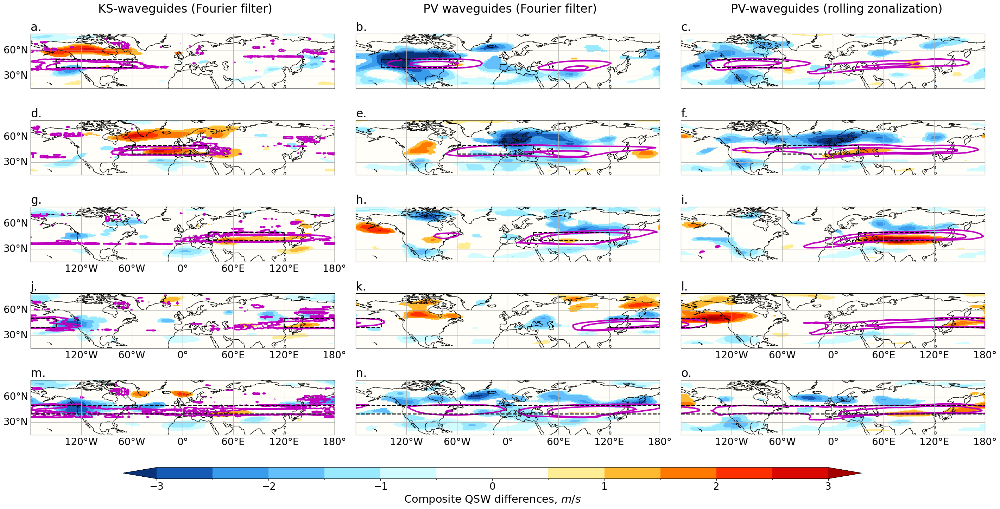

In [23]:
# Ks, PVF, and PV (345) comparison - NH summer - QSW anoms from smooth seasonal clim, high - low
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'JJA'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

wn_min = 4
wn_max=15

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 
    
nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + 
                                    '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
data_ERA5 = xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_wns' + str(wn_min) + '-' + str(wn_max) + 
                         '_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc').QSW_envelope

data_ERA5 = data_ERA5.sel(time=slice('1980','2022'))

data_ERA5_group = data_ERA5.groupby('time.season')

data_ERA5_seas={}
for iseas,data in data_ERA5_group:
    data_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(0,35)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(-35,0)).values[...] = 0.0
        
        
    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3,5],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3,5],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(35,0)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(0,-35)).values[...] = 0.0
      
    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 5:
        plt.text(-100,105,'PV waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite QSW differences, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.png',dpi=300)

plt.show()

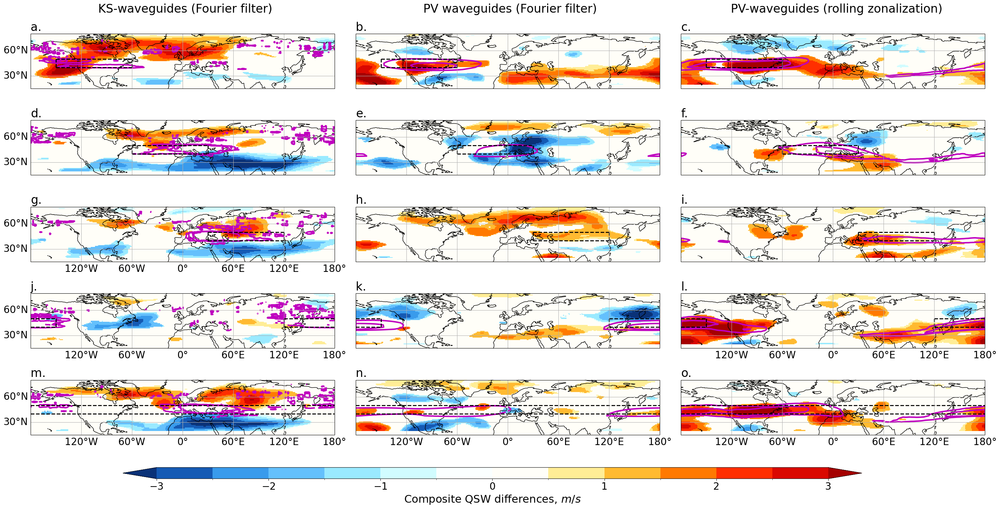

In [24]:
# Ks, PVF, and PV (330) comparison - NH winter - QSW anoms from smooth seasonal clim, high - low
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'NH'
season = 'DJF'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

wn_min = 4
wn_max=15

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 
    
nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + 
                                    '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
data_ERA5 = xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_wns' + str(wn_min) + '-' + str(wn_max) + 
                         '_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc').QSW_envelope

data_ERA5 = data_ERA5.sel(time=slice('1980','2022'))

data_ERA5_group = data_ERA5.groupby('time.season')

data_ERA5_seas={}
for iseas,data in data_ERA5_group:
    data_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(0,35)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(-35,0)).values[...] = 0.0
        
        
    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3,5],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3,5],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  

        
        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(35,0)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(0,-35)).values[...] = 0.0
      
    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 5:
        plt.text(-100,105,'PV waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 6:
        plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite QSW differences, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.png',dpi=300)

plt.show()

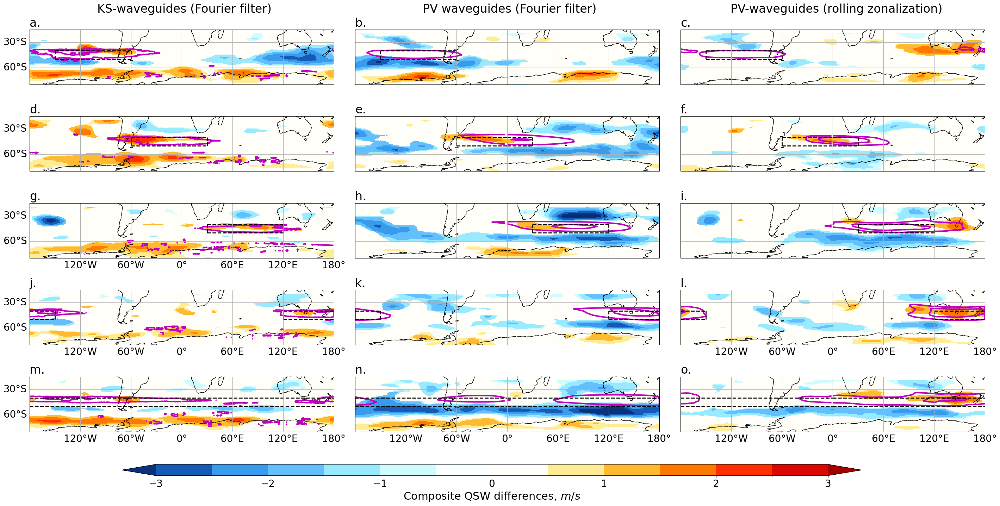

In [25]:
# Ks, PVF, and PV (345) comparison - SH summer - QSW anoms from smooth seasonal clim, high - low
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'DJF'
seasonname = 'Summer'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

wn_min = 4
wn_max=15

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 
    
nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + 
                                    '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
data_ERA5 = xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_wns' + str(wn_min) + '-' + str(wn_max) + 
                         '_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc').QSW_envelope

data_ERA5 = data_ERA5.sel(time=slice('1980','2022'))

data_ERA5_group = data_ERA5.groupby('time.season')

data_ERA5_seas={}
for iseas,data in data_ERA5_group:
    data_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(0,35)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(-35,0)).values[...] = 0.0
        
        
    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  

        
        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(35,0)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(0,-35)).values[...] = 0.0
      
    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 5:
        plt.text(-100,5,'PV waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite QSW differences, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.png',dpi=300)

plt.show()

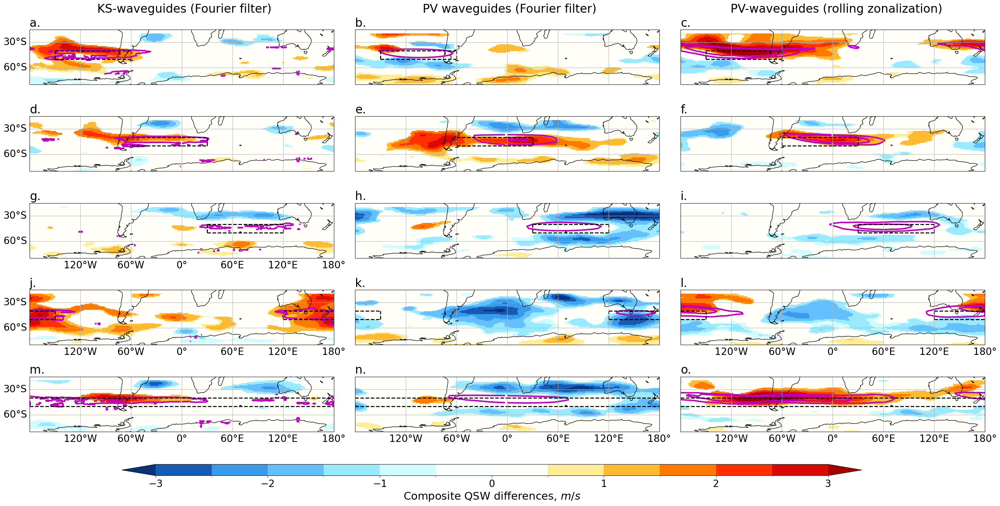

In [26]:
# Ks, PVF, and PV (330) comparison - SH winter - QSW anoms from smooth seasonal clim, high - low
# thinner boxes in new locations, lat weighting to wgs, bootstrap masking to 5%, every 5th value; unfiltered U differences with WG anomalies - extend to multiple regions, summer on one side, winter on the other. 
hemi = 'SH'
season = 'JJA'
seasonname = 'Winter'

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

wn_min = 4
wn_max=15

fig = plt.figure(figsize=(35,16))
matplotlib.rcParams.update({'font.size':20})

reg_lons1 = [210,300,30,120,0]
reg_lons2 = [300,30,120,210,359.9]
if hemi == 'NH':
    reg_lats1 = [40,40,40,40,40]
    reg_lats2 = [50,50,50,50,50]
elif hemi == 'SH':
    reg_lats1 = [-50,-50,-50,-50,-50]
    reg_lats2 = [-40,-40,-40,-40,-40] 
    
nregs = 5

startsel = 0
skipsel = 5

timefilter = 15
wavelfilter = 2

filename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'
WG_ERA5 = xr.open_dataset(dirin + 'Waveguides/' + filename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) + 
                                    '_0.5_1_5.nc').WG_map[startsel::skipsel,:,:,:]

WG_here = WG_ERA5.sel(time=slice('1980','2022'))

# Sum over all wavenumbers
WG_ERA5_total_depth = WG_here.sum(dim='k')
# Max over all wavenumbers
WG_ERA5_max_depth = WG_here.max(dim='k')

# Mask to only where waveguides and then take seasonal slice
WG_ERA5_wgs = xr.where(WG_ERA5_total_depth>0,WG_ERA5_total_depth,np.nan)

WG_ERA5_group = WG_ERA5_wgs.groupby('time.season')

WG_ERA5_seas = {}
for iseas,data in WG_ERA5_group:
    WG_ERA5_seas[iseas] = data     

# Read in U and WG anoms:
data_ERA5 = xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_wns' + str(wn_min) + '-' + str(wn_max) + 
                         '_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc').QSW_envelope

data_ERA5 = data_ERA5.sel(time=slice('1980','2022'))

data_ERA5_group = data_ERA5.groupby('time.season')

data_ERA5_seas={}
for iseas,data in data_ERA5_group:
    data_ERA5_seas[iseas] = data

n=1

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    # select region
    
    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_ERA5_wgs.sel(longitude=slice(lon1,360)),WG_ERA5_wgs.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_ERA5_reg = WG_ERA5_wgs.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])
        
    WG_ERA5_reg = (WG_ERA5_reg * np.cos(np.deg2rad(WG_ERA5_reg.latitude))).mean(dim='latitude')

    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for iseas,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[iseas] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')

    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    if n<10:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(0,35)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(-35,0)).values[...] = 0.0
        
        
    if seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)
    elif seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[2,4],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
        
    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    plt.title(labels[n-4],loc='left')
    plt.title('')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 4:
        plt.text(-100,5,'KS-waveguides (Fourier filter)',fontsize=24)  

        
        
n=2

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVFwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_filtered[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    if hemi == 'NH':
        toplot.sel(latitude = slice(35,0)).values[...] = 0.0
    elif hemi == 'SH':
        toplot.sel(latitude = slice(0,-35)).values[...] = 0.0
      
    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 5:
        plt.text(-100,5,'PV waveguides (Fourier filter)',fontsize=24)  
        
n=3

for ireg in np.arange(0,nregs):
    lon1 = reg_lons1[ireg]
    lon2 = reg_lons2[ireg]
    lat1 = reg_lats1[ireg]
    lat2 = reg_lats2[ireg]
    
    WGlon1 = lon1
    WGlon2 = lon2  
    
    # select region
    
    WG_here = PVwgs[season][hemi].sel(isentrope=seasise[seasonname]).ngl_pv_rz[startsel::skipsel,:,:]

    # Mask to only where waveguides and then take seasonal slice
    #WG_ERA5_wgs = xr.where(WG_here > 1.2E-6,WG_here,np.nan)

    WG_ERA5_group = WG_here.groupby('time.season')

    WG_ERA5_seas = {}
    for seashere,data in WG_ERA5_group:
        WG_ERA5_seas[seashere] = data     


    if lon1 > lon2:
        WG_ERA5_reg = xr.concat([WG_here.sel(longitude=slice(WGlon1,180)),WG_here.sel(longitude=slice(-180,WGlon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['latitude','longitude'])
    else:
        WG_ERA5_reg = WG_here.sel(longitude=slice(WGlon1,WGlon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['latitude','longitude'])


    WG_ERA5_reg_group = WG_ERA5_reg.groupby('time.season')

    WG_ERA5_reg_seas = {}
    for seashere,data in WG_ERA5_reg_group:
        WG_ERA5_reg_seas[seashere] = data

    # Calculate 90 %ile
    thresholds = WG_ERA5_reg_seas[season].quantile([0.1,0.9], dim='time')

    # Make plot

    high_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)

    low_WG_data = data_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)

    high_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] >= thresholds.sel(quantile=0.9),drop=True)    

    low_WG = WG_ERA5_seas[season].where(
            WG_ERA5_reg_seas[season] <= thresholds.sel(quantile=0.1),drop=True)    

    numhigh = len(high_WG_data)
    numlow = len(low_WG_data)

    ax = plt.subplot(nregs,3,n,projection=ccrs.PlateCarree()); n+=3
    ax.coastlines(color='k')
    gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
    gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
    gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
    gl.top_labels = False
    gl.right_labels = False
    gl.left_labels = False
    if n<15:
        gl.bottom_labels = False

    diffs = high_WG_data.mean(dim='time') - low_WG_data.mean(dim='time')

    masked_diffs = xr.where(np.any([diffs > QSWdiffs_95[hemi][wn_min][season],
                                    diffs < QSWdiffs_05[hemi][wn_min][season]],axis=0),diffs,0)

    plot = masked_diffs.plot(cmap=cmap_wc,transform=ccrs.PlateCarree(),
                                                levels = np.arange(-3,3.1,0.5),
                                                extend='both',add_colorbar=False)

    toplot = (high_WG.mean(dim='time') - low_WG.mean(dim='time'))
    toplot.sel(latitude = slice(0,35)).values[...] = 0.0

    if seasonname == 'Winter':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)
    elif seasonname == 'Summer':
        toplot.plot.contour(colors='m',transform=ccrs.PlateCarree(),levels=[3E-7,6E-7],linewidths=3)

    if hemi == 'NH':
        plt.ylim(15,80)
    elif hemi == 'SH':
        plt.ylim(-80,-15)
    
    plt.title('')

    if lon1 != 0:
        plt.plot([lon1,lon1],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon2,lon2],[lat1,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())

    if lon1 < lon2:
        plt.plot([lon1,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
    else:
        plt.plot([lon1,360],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([lon1,360],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat1,lat1],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())
        plt.plot([0,lon2],[lat2,lat2],color='k',linestyle='--',linewidth=2,transform=ccrs.PlateCarree())


    plt.title(labels[n-4],loc='left')
    #plt.title(iseas + ' U high (n=' + str(numhigh) + ') - low (n=' + str(numlow) + ') N. Am WG events; k = ' + str(ik) + 
    #          '; tf = ' + str(timefilter) + '; wn <= ' + str(wavelfilter),fontsize=18)
    if n == 6:
        plt.text(-121,5,'PV-waveguides (rolling zonalization)',fontsize=24)  

# create common colorbar
cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.02])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Composite QSW differences, $m/s$', size=22)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0)
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/' + hemi + '_' + season + '_QSWanoms_diffs_bs_PV345_KS_PVF_Dec12.png',dpi=300)

plt.show()

## QSW correlations

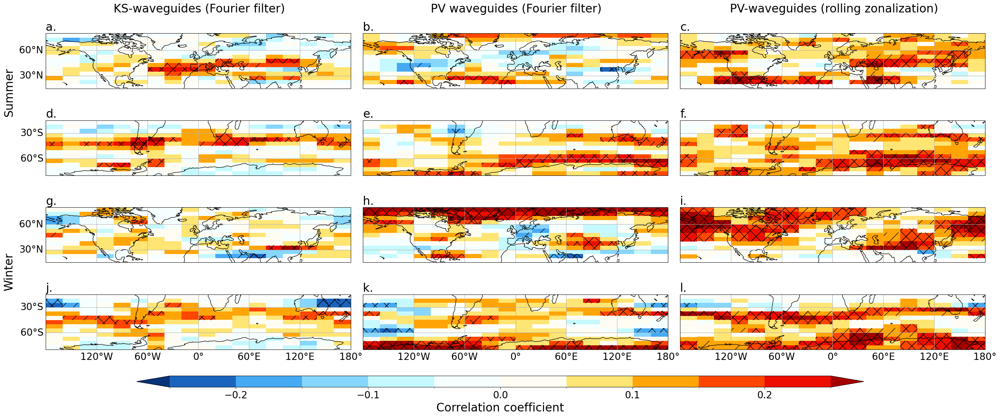

In [27]:
# Plot 300mb with PV-FF no Tukey, with FDR - raveled - with my QSWs v2 4-15
fig = plt.figure(figsize=(35,13))
matplotlib.rcParams.update({'font.size':20})

latboxsize = 5
lonboxsize = 20
latstart = 20
latend = 80
lonstart = 0
lonend = 360
timefilter = 15
wavelfilter = 2

startsel = 0
skipsel = 10

pval = 0.1

labels = ['a.','b.','c.','d.','e.','f.','g.','h.','i.','j.','k.','l.','m.','n.']

# Plot KS-waveguides
WGfilename = 'ERA5_NH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) +
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
n=1
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')
plt.text(-100,105,'KS-waveguides (Fourier filter)',fontsize=24)  


plt.text(-230,-15,'Summer',fontsize=24,rotation=90)

# Southern hemisphere
WGfilename = 'ERA5_SH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) +
                                       '_ERA5_SH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'DJF'
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')

# Winter

WGfilename = 'ERA5_NH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) +
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'DJF'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')

plt.text(-230,-15,'Winter',fontsize=24,rotation=90)


WGfilename = 'ERA5_SH_300mb_dailymean_1x1_1979-2022_WG'
map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) +
                                       '_ERA5_SH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False

plot = map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')




# Now PV waveguides - fourier filter
n =2

map_corr = xr.open_dataset(dirin + '/PV/PVWGmap_QSWcorr_PV_ZF_WGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')

season = 'JJA'
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

pvalues = map_corr.pvalue.sel(seas=season).copy(deep=True)
pvalues = xr.where(np.isnan(pvalues),1,pvalues) # get rid of nans for FDR

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(pvalues.values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')

plt.text(-100,105,'PV waveguides (Fourier filter)',fontsize=24)  
# Southern hemisphere
map_corr = xr.open_dataset(dirin + '/PV/PVWGmap_QSWcorr_PV_ZF_WGanoms_SH_DJF_345_JJA_330_ERA5' + 
                                           '_QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')


season = 'DJF'
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

pvalues = map_corr.pvalue.sel(seas=season).copy(deep=True)
pvalues = xr.where(np.isnan(pvalues),1,pvalues) # get rid of nans for FDR

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(pvalues.values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')


# Winter

map_corr = xr.open_dataset(dirin + '/PV/PVWGmap_QSWcorr_PV_ZF_WGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')

season = 'DJF'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

pvalues = map_corr.pvalue.sel(seas=season).copy(deep=True)
pvalues = xr.where(np.isnan(pvalues),1,pvalues) # get rid of nans for FDR
# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(pvalues.values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')


map_corr = xr.open_dataset(dirin + '/PV/PVWGmap_QSWcorr_PV_ZF_WGanoms_SH_DJF_345_JJA_330_ERA5' +  
                                           '_QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')

season = 'JJA'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

plot = map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

pvalues = map_corr.pvalue.sel(seas=season).copy(deep=True)
pvalues = xr.where(np.isnan(pvalues),1,pvalues) # get rid of nans for FDR
# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(pvalues.values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')




# Now PV waveguides
n =3

map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')

plt.text(-121,105,'PV-waveguides (rolling zonalization)',fontsize=24)  
# Southern hemisphere
map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_SH_DJF_345_JJA_330_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')


season = 'DJF'
ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')


# Winter

map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'DJF'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.bottom_labels = False
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')


map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_SH_DJF_345_JJA_330_ERA5' +  
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'

ax = plt.subplot(4,3,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=3
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
gl.left_labels = False

plot = map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                           add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(-80,-15)
plt.title(labels[n-4],loc='left')
plt.title('',loc='center')



cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.025])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Correlation coefficient', size=24)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.04, hspace=0.02)

fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/WG_QSW_KS_PVFF_PV_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/WG_QSW_KS_PVFF_PV_Dec12.png',dpi=300)


plt.show()

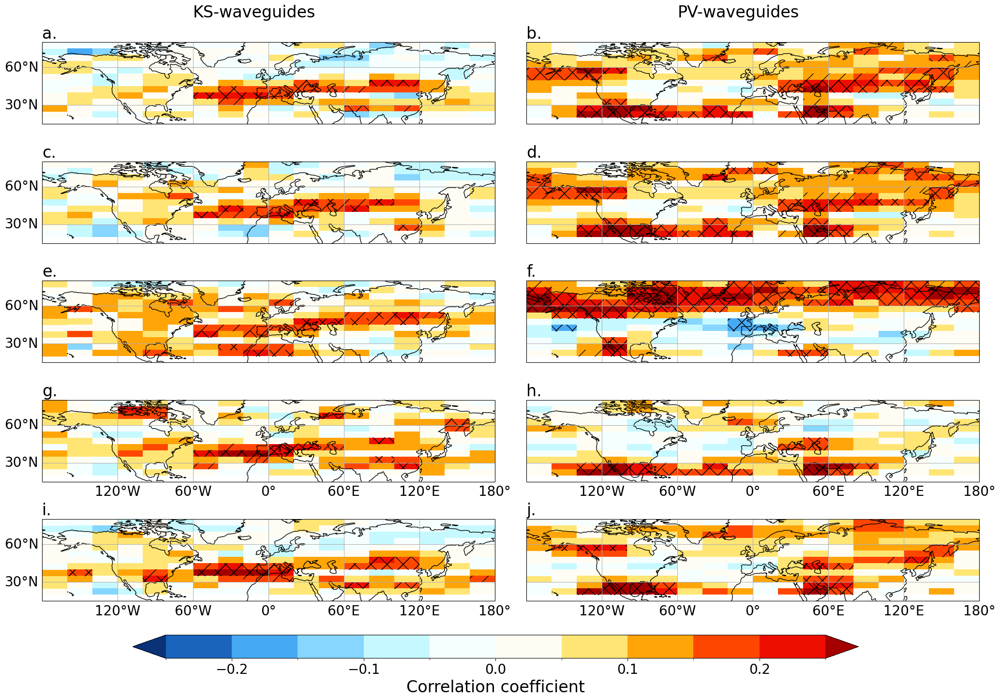

In [28]:
# Plot sensitivity - 
# KS1: resolution; PV1: 340K
# KS2: 500-mb; PV2: 330K
# KS3: QSWs with wn6-15; PV3: QSWs with wn6-15.

fig = plt.figure(figsize=(25,16))
matplotlib.rcParams.update({'font.size':20})

latboxsize = 5
lonboxsize = 20
latstart = 20
latend = 80
lonstart = 0
lonend = 360
timefilter = 15
wavelfilter = 2

startsel = 0
skipsel = 10

n=1 

pval = 0.1

labels = ['a.','b.','c.','d.','e.','f.','g.','h.','i.','j.','k.','l.']

# Plot KS-waveguides

WGfilename = 'ERA5_NH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                    str(timefilter) + '_zfnt' +  str(wavelfilter) +
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'

ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
if n<6:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')
plt.text(-60,100,'KS-waveguides',fontsize=24)

# Now PV waveguides

map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
if n<6:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')

plt.text(-60,100,'PV-waveguides',fontsize=24)  


# Plot KS-waveguides

WGfilename = 'ERA5_NH_300mb_dailymean_2.5x2.5_1979-2022_WG'

minwidth=5
mindepth =1 

timefilter = 15
wavelfilter = 2
addname = ''

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map' + addname + '_tf' + 
                                    str(timefilter) + '_zf' +  str(wavelfilter) + 
                                     '_0.5_' + str(mindepth) + '_' + str(minwidth) + 
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
if n<6:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
plot = map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

if addname == '_maxdepth':
    pvalues_masknan = np.where(np.isnan(map_corr.pvalue.sel(seas=season).values),0.0,map_corr.pvalue.sel(seas=season).values)
    adjusted_pvalue = scipy.stats.false_discovery_control(pvalues_masknan, axis=None, method='by')
else:
    adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('')

# Pv waveguides on 2.5 degree grid
    
map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_grid2_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')



wavelfilter=2
minwidth=5
timefilter = 15
mindepth =1 
    
addname = ''
WGfilename = 'ERA5_NH_500mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map' + addname + '_tf' + 
                                    str(timefilter) + '_zf' +  str(wavelfilter) + 
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('')
    
    
map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_NH_DJF_330_JJA_330_ERA5' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')


# KS-waveguides wns6-15

minwidth=5
mindepth =1 

timefilter = 15
wavelfilter = 2
addname = ''
WGfilename = 'ERA5_NH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map' + addname + '_tf' + 
                                    str(timefilter) + '_zf' +  str(wavelfilter) +
                                       '_ERA5_NH_QSW_envelope_wns6-15_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
    

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('')

# PV waveguides wn 6-15
 
map_corr = xr.open_dataset(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_wns6-15_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([-120,-60,0,60,120,180])
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
    
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')

# KS-waveguides wavelfilter 3

minwidth=5
mindepth =1 

timefilter = 15
wavelfilter = 3
addname = ''
WGfilename = 'ERA5_NH_300mb_dailymean_1x1_1979-2022_WG'

map_corr = xr.open_dataset(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map' + addname + '_tf' + 
                                    str(timefilter) + '_zf' +  str(wavelfilter) +
                                       '_ERA5_NH_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                        str(startsel) + '_' + str(skipsel) + '_' + 
                                        str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
    

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(map_corr.pvalue.sel(seas=season).values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(map_corr.pvalue.sel(seas=season).values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('')
 

# PV waveguides with 120 degree zonalization

map_corr = xr.open_dataset(dirin + '/PV/PVWGmap_QSWcorr_PV120WGanoms_NH_DJF_330_JJA_345_ERA5' + 
                                           '_QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')

season = 'JJA'
ax = plt.subplot(5,2,n,projection=ccrs.PlateCarree(central_longitude=0)); n+=1
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([-120,-60,0,60,120,180])
if n<8:
    gl.bottom_labels = False
if n%2 == 1:
    gl.left_labels = False
    
gl.top_labels = False
gl.right_labels = False

map_corr.corr_coeff_r.sel(seas=season).plot(cmap=cmap_wc,extend='both',levels = np.arange(-0.25,0.26,0.05),
                                            add_colorbar=False)

pvalues = map_corr.pvalue.sel(seas=season).copy(deep=True)
pvalues = xr.where(np.isnan(pvalues),1,pvalues) # get rid of nans for FDR

# Adjust p-values using False Discovery Rate:
# Use Benjaminini-Yekutieli (Theorem 1.3) as tests are NOT independent due to spatial correlation
adjusted_pvalue = scipy.stats.false_discovery_control(pvalues.values, axis=None, method='by')
adjusted_pvalue = adjusted_pvalue.reshape(pvalues.values.shape)

mask_map_corr = xr.where(adjusted_pvalue < pval,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='/',alpha=0.,transform=ccrs.PlateCarree())

mask_map_corr = xr.where(adjusted_pvalue < pval/2,1,np.nan)

plt.pcolor(map_corr.lons, map_corr.lats, mask_map_corr, 
                        hatch='x',alpha=0.,transform=ccrs.PlateCarree())

plt.ylim(15,80)
plt.title(labels[n-2],loc='left')
plt.title('',loc='center')



cbar_ax = fig.add_axes([0.2, 0.06, 0.6, 0.03])
cb = fig.colorbar(plot, cax=cbar_ax,orientation='horizontal')
cb.set_label(label='Correlation coefficient', size=24)

#plt.colorbar(plot)
plt.subplots_adjust(wspace=0.07, hspace=0.0)

fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/WG_QSW_KS_PV_sens_Dec12.eps')
fig.savefig('/scratch/st-rwhite01-1/rwhite01/Papers/InPrep/Waveguides/' + 
            'Figures/WG_QSW_KS_PV_sens_Dec12.png',dpi=300)

plt.show()


## Example code to calculate climatology and correlation files

### Calculate climatologies and anomalies

In [ ]:
# Calculate z smooth climatology and anomalies from
from scipy.signal import savgol_filter


datain = xr.open_dataset(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1.nc').z
datain = datain.sel(time=slice('1980','2022'))
datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

nyears = int(len(datain_noleap.time)/365)


daily_Z_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,365,
                                                    len(datain_noleap.lat),len(datain_noleap.lon)]).mean(axis=0),
                                                     dims=('time','latitude','longitude'),
                                                     coords={'time':np.arange(0,365),
                                                             'latitude':datain_noleap.lat.values,
                                                             'longitude':datain_noleap.lon.values})
# Tile to wrap around DJF
daily_Z_clim_rep = xr.DataArray(np.tile(daily_Z_clim.values,[3,1,1]),
                                                     dims=('time','latitude','longitude'),
                                                     coords={'time':np.arange(0,365*3),
                                                             'latitude':datain_noleap.lat.values,
                                                             'longitude':datain_noleap.lon.values})

# created smoothed climatology at each point
daily_Z_clim_smooth = daily_Z_clim.copy(deep=True)

for ilat in range(0,len(daily_Z_clim.latitude)):
    for ilon in range(0,len(daily_Z_clim.longitude)):
            filtered = savgol_filter(daily_Z_clim_rep[:,ilat,ilon],
                                window_length=61, polyorder=1)
            daily_Z_clim_smooth[:,ilat,ilon] = filtered[365:365+365]


daily_Z_clim_smooth= daily_Z_clim_smooth.to_dataset(name='z_clim')
daily_Z_clim_smooth.attrs["description"] = ("Z500 1980-2022 smooth climatology with savgol_filter" +
                            "with window length = 61 and polyorder = 1, wrapped to create continuity in DJF")

daily_Z_clim_smooth.to_netcdf(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_smooth_clim.nc')

daily_Z_clim_anoms = datain_noleap - np.tile(daily_Z_clim_smooth.z_clim,(nyears,1,1))
daily_Z_clim_anoms.to_netcdf(dirinraw + '/ERA5_z_1979-2018_daily_500_1*1_anoms_from_smooth_clim.nc')


In [ ]:
# Calculate U300 smooth climatology and anomalies from
from scipy.signal import savgol_filter

datain = xr.open_dataset(dirinraw + '/u/ERA5_u_850_250_dailymean_1degree_1979-2022.nc').sel(level=300).u
datain = datain.sel(time=slice('1980','2022'))
datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

nyears = int(len(datain_noleap.time)/365)


daily_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,365,
                                                    len(datain_noleap.latitude),len(datain_noleap.longitude)]).mean(axis=0),
                                                     dims=('time','latitude','longitude'),
                                                     coords={'time':np.arange(0,365),
                                                             'latitude':datain_noleap.latitude.values,
                                                             'longitude':datain_noleap.longitude.values})
# Tile to wrap around DJF
daily_clim_rep = xr.DataArray(np.tile(daily_clim.values,[3,1,1]),
                                                     dims=('time','latitude','longitude'),
                                                     coords={'time':np.arange(0,365*3),
                                                             'latitude':datain_noleap.latitude.values,
                                                             'longitude':datain_noleap.longitude.values})

# created smoothed climatology at each point
daily_clim_smooth = daily_clim.copy(deep=True)

for ilat in range(0,len(daily_clim.latitude)):
    for ilon in range(0,len(daily_clim.longitude)):
            filtered = savgol_filter(daily_clim_rep[:,ilat,ilon],
                                window_length=61, polyorder=1)
            daily_clim_smooth[:,ilat,ilon] = filtered[365:365+365]


daily_clim_smooth= daily_clim_smooth.to_dataset(name='u_clim')
daily_clim_smooth.attrs["description"] = ("U300 1980-2022 smooth climatology with savgol_filter" +
                            "with window length = 61 and polyorder = 1, wrapped to create continuity in DJF")

daily_clim_smooth.to_netcdf(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_smooth_clim.nc')

daily_clim_anoms = datain_noleap - np.tile(daily_clim_smooth.u_clim,(nyears,1,1))
daily_clim_anoms.to_netcdf(dirinraw + '/ERA5_U300_1979-2018_daily_1*1_anoms_from_smooth_clim.nc')


In [ ]:
# Calculate PV smooth climatology and anomalies from

from scipy.signal import savgol_filter

seasise = {}
seasise['Summer'] = '345'
seasise['Winter'] = '330'

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

for hemi in ['NH','SH']:
    for seas in ['JJA','DJF']:
        print(seas)

        isent = seasise[seasons[seas][hemi]]
        datain = PVwgs[seas][hemi].sel(isentrope=isent).ngl_pv_rz
        datain = datain.sel(time=slice('1980','2022'))
        datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

        
        if seas == 'JJA':
            ndays = 92
        else:
            ndays = 90
            
        nyears = int(len(datain_noleap.time)/ndays)


        daily_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,ndays,
                                                            len(datain_noleap.latitude),len(datain_noleap.longitude)]).mean(axis=0),
                                                             dims=('time','latitude','longitude'),
                                                             coords={'time':np.arange(0,ndays),
                                                                     'latitude':datain_noleap.latitude.values,
                                                                     'longitude':datain_noleap.longitude.values})
        # created smoothed climatology at each point
        daily_clim_smooth = daily_clim.copy(deep=True)

        for ilat in range(0,len(daily_clim.latitude)):
            for ilon in range(0,len(daily_clim.longitude)):
                    daily_clim_smooth[:,ilat,ilon] = savgol_filter(daily_clim[:,ilat,ilon],
                                        window_length=61, polyorder=1)


        daily_clim_smooth= daily_clim_smooth.to_dataset(name='gradlnPV_clim')
        daily_clim_smooth.attrs["description"] = ('gradlnPV at ' + isent +  ' 1980-2022 smooth climatology with savgol_filter' +
                                    'with window length = 61 and polyorder = 1, no wrapping')

        daily_clim_smooth.to_netcdf(dirinraw + '/ERA5_PVWG_' + str(isent) + 'K_1980-2022_daily_1*1_smooth_clim.nc')

        daily_clim_anoms = datain_noleap - np.tile(daily_clim_smooth.gradlnPV_clim,(nyears,1,1))
        daily_clim_anoms.to_netcdf(dirinraw + '/ERA5_PVWG_' + str(isent) + 'K_' + hemi + '_' + seas + 
                                       '_1980-2022_daily_1*1_anoms_from_smooth_clim.nc')



In [ ]:
# Sensitivity - 2.5 degrees Calculate PV smooth climatology and anomalies from

PVwg_NH_25 = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
                      'waveguide_era5_JJA_NH_grid2.nc').sel(latitude=slice(85,10))

#PVwg_SH = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/PV_waveguides/' + 
#                      'waveguide_era5_raw.nc').sel(latitude=slice(-20,-80))


from scipy.signal import savgol_filter

seasise = {}
seasise['Summer'] = '345'
seasise['Winter'] = '330'

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

for hemi in ['NH']:
    for seas in ['JJA']:
        print(seas)

        isent = seasise[seasons[seas][hemi]]
        datain = PVwg_NH_25.sel(isentrope=isent).ngl_pv_rz
        datain = datain.sel(time=slice('1980','2022'))
        datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

        
        if seas == 'JJA':
            ndays = 92
        else:
            ndays = 90
            
        nyears = int(len(datain_noleap.time)/ndays)


        daily_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,ndays,
                                                            len(datain_noleap.latitude),len(datain_noleap.longitude)]).mean(axis=0),
                                                             dims=('time','latitude','longitude'),
                                                             coords={'time':np.arange(0,ndays),
                                                                     'latitude':datain_noleap.latitude.values,
                                                                     'longitude':datain_noleap.longitude.values})
        # created smoothed climatology at each point
        daily_clim_smooth = daily_clim.copy(deep=True)

        for ilat in range(0,len(daily_clim.latitude)):
            for ilon in range(0,len(daily_clim.longitude)):
                    daily_clim_smooth[:,ilat,ilon] = savgol_filter(daily_clim[:,ilat,ilon],
                                        window_length=61, polyorder=1)


        daily_clim_smooth= daily_clim_smooth.to_dataset(name='gradlnPV_clim')
        daily_clim_smooth.attrs["description"] = ('gradlnPV at ' + isent +  ' 1980-2022 smooth climatology with savgol_filter' +
                                    'with window length = 61 and polyorder = 1, no wrapping')

        daily_clim_smooth.to_netcdf(dirinraw + '/ERA5_PVWG_grid2_' + str(isent) + 'K_1980-2022_daily_1*1_smooth_clim.nc')

        daily_clim_anoms = datain_noleap - np.tile(daily_clim_smooth.gradlnPV_clim,(nyears,1,1))
        daily_clim_anoms.to_netcdf(dirinraw + '/ERA5_PVWG_grid2_' + str(isent) + 'K_' + hemi + '_' + seas + 
                                       '_1980-2022_daily_1*1_anoms_from_smooth_clim.nc')



In [ ]:
# Fourier filtered - NH DJF  - Calculate PV smooth climatology and anomalies from
PVdataout = '/scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/PV/'

PVwg_DJF_NH_FS = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/' +
                        'PV_waveguides/Fourier_decomp/' + 
                      'waveguide_filtered_pv_era5_DJF_79_22.nc').sel(latitude=slice(85,10))


from scipy.signal import savgol_filter

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

for hemi in ['NH']:
    for seas in ['DJF']:
        print(seas)

        isent = seasise[seasons[seas][hemi]]
        print(isent)
        datain = PVwg_DJF_NH_FS.sel(isentrope=isent).ngl_pv_filtered
        datain = datain.sel(time=slice('1980','2019'))
        datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

        
        if seas == 'JJA':
            ndays = 92
        else:
            ndays = 90
            
        nyears = int(len(datain_noleap.time)/ndays)


        daily_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,ndays,
                                                            len(datain_noleap.latitude),len(datain_noleap.longitude)]).mean(axis=0),
                                                             dims=('time','latitude','longitude'),
                                                             coords={'time':np.arange(0,ndays),
                                                                     'latitude':datain_noleap.latitude.values,
                                                                     'longitude':datain_noleap.longitude.values})
        # created smoothed climatology at each point
        daily_clim_smooth = daily_clim.copy(deep=True)

        for ilat in range(0,len(daily_clim.latitude)):
            for ilon in range(0,len(daily_clim.longitude)):
                    daily_clim_smooth[:,ilat,ilon] = savgol_filter(daily_clim[:,ilat,ilon],
                                        window_length=61, polyorder=1)


        daily_clim_smooth= daily_clim_smooth.to_dataset(name='gradlnPV_clim')
        daily_clim_smooth.attrs["description"] = ('gradlnPV at ' + str(isent) +  ' 1980-2022 smooth climatology with savgol_filter' +
                                    'with window length = 61 and polyorder = 1, no wrapping')

        daily_clim_smooth.to_netcdf(PVdataout + '/waveguide_filtered_pv_era5_' + str(isent) + 'K_' + 
                                    hemi + '_' + seas + '_1980-2019_daily_1*1_smooth_clim.nc')

        daily_clim_anoms = datain_noleap - np.tile(daily_clim_smooth.gradlnPV_clim,(nyears,1,1))
        daily_clim_anoms.to_netcdf(PVdataout + '/waveguide_filtered_pv_era5_' + str(isent) + 'K_' + 
                                   hemi + '_' + seas + 
                                       '_1980-2019_daily_1*1_anoms_from_smooth_clim.nc')



In [ ]:
# 120 rolling - NH DJF  - Calculate PV smooth climatology and anomalies from
PVdataout = '/scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/PV/'

waveguides = xr.open_dataset('/arc/project/st-rwhite01-1/rwhite01/waveguides/reanalysis/ERA5/' +
                        'PV_waveguides/Zonalized120/' + 
                      'waveguide120_era5_DJF_79_22.nc').sel(latitude=slice(85,10))


from scipy.signal import savgol_filter

seasise = {}
seasise['Summer'] = 345
seasise['Winter'] = 330

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

for hemi in ['NH']:
    for seas in ['DJF']:
        print(seas)

        isent = seasise[seasons[seas][hemi]]
        print(isent)
        datain = waveguides.sel(isentrope=isent).ngl_pv_rz
        datain = datain.sel(time=slice('1980','2019'))
        datain_noleap = datain.sel(time=~((datain.time.dt.month == 2) & (datain.time.dt.day == 29)))

        
        if seas == 'JJA':
            ndays = 92
        else:
            ndays = 90
            
        nyears = int(len(datain_noleap.time)/ndays)


        daily_clim = xr.DataArray(np.reshape(datain_noleap.values,[nyears,ndays,
                                                            len(datain_noleap.latitude),len(datain_noleap.longitude)]).mean(axis=0),
                                                             dims=('time','latitude','longitude'),
                                                             coords={'time':np.arange(0,ndays),
                                                                     'latitude':datain_noleap.latitude.values,
                                                                     'longitude':datain_noleap.longitude.values})
        # created smoothed climatology at each point
        daily_clim_smooth = daily_clim.copy(deep=True)

        for ilat in range(0,len(daily_clim.latitude)):
            for ilon in range(0,len(daily_clim.longitude)):
                    daily_clim_smooth[:,ilat,ilon] = savgol_filter(daily_clim[:,ilat,ilon],
                                        window_length=61, polyorder=1)


        daily_clim_smooth= daily_clim_smooth.to_dataset(name='gradlnPV_clim')
        daily_clim_smooth.attrs["description"] = ('gradlnPV at ' + str(isent) +  ' 1980-2022 smooth climatology with savgol_filter' +
                                    'with window length = 61 and polyorder = 1, no wrapping')

        daily_clim_smooth.to_netcdf(PVdataout + '/waveguide_120lon_pv_era5_' + str(isent) + 'K_' + 
                                    hemi + '_' + seas + '_1980-2019_daily_1*1_smooth_clim.nc')

        daily_clim_anoms = datain_noleap - np.tile(daily_clim_smooth.gradlnPV_clim,(nyears,1,1))
        daily_clim_anoms.to_netcdf(PVdataout + '/waveguide_120lon_pv_era5_' + str(isent) + 'K_' + 
                                   hemi + '_' + seas + 
                                       '_1980-2019_daily_1*1_anoms_from_smooth_clim.nc')



### Calculate correlations between waveguides and waves

In [ ]:
def avg_QSW_reg(QSW_anoms,lat1,lat2,lon1,lon2):
 
    if lon1 > lon2:
        QSW_reg = xr.concat([QSW_anoms.sel(longitude=slice(lon1,360)),QSW_anoms.sel(longitude=slice(0,lon2))],
                                dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                dim=['longitude'])
    else:
        QSW_reg = QSW_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat2,lat1)).mean(
                        dim=['longitude'])

    coslat = np.cos(np.deg2rad(QSW_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    QSW_reg = (QSW_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')
    
    QSW_reg_seas = {}

    for seas,data in QSW_reg.groupby('time.season'):
        QSW_reg_seas[seas] = data
        
    QSW_reg_seas['ANN'] = QSW_reg
    
    return(QSW_reg_seas)

def avg_WGmap_reg(WG_anoms,lat1,lat2,lon1,lon2):

    if lon1 > lon2:
        WG_reg = xr.concat([WG_anoms.sel(longitude=slice(lon1,360)),WG_anoms.sel(longitude=slice(0,lon2))],
                                    dim='longitude').sel(latitude=slice(lat1,lat2)).mean(
                                    dim=['longitude'])
    else:
        WG_reg = WG_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat1,lat2)).mean(
                            dim=['longitude'])

    coslat = np.cos(np.deg2rad(WG_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    WG_reg = (WG_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')

    WG_reg_seas = {}

    for seas,data in WG_reg.groupby('time.season'):
        WG_reg_seas[seas] = data

    WG_reg_seas['ANN'] = WG_reg
        
    return(WG_reg_seas)

def avg_PVWGmap_reg(WG_anoms,lat1,lat2,lon1,lon2):

    if lon1 > 180: lon1 = lon1 - 360
    if lon2 > 180: lon2 = lon2 - 360
    
    # select region
    
    if lon1 > lon2:
        WG_reg = xr.concat([WG_anoms.sel(longitude=slice(lon1,180)),WG_anoms.sel(longitude=slice(-180,lon2))],
                                    dim='longitude').sel(latitude=slice(lat2,lat1)).mean(
                                    dim=['longitude'])
    else:
        WG_reg = WG_anoms.sel(longitude=slice(lon1,lon2)).sel(latitude=slice(lat2,lat1)).mean(
                            dim=['longitude'])
    coslat = np.cos(np.deg2rad(WG_reg.latitude))
    #QSW_reg_noweight = QSW_reg.mean(dim='latitude')
    WG_reg = (WG_reg * coslat).mean(dim='latitude')/coslat.mean(dim='latitude')

    WG_reg_seas = {}
    
    for seas,data in WG_reg.groupby('time.season'):
        WG_reg_seas[seas] = data

    WG_reg_seas['ANN'] = WG_reg
        
    return(WG_reg_seas)

In [ ]:
# Test autocorrelation
timefilter = 15
QSW_anoms = xr.open_dataset(dirin + '/QSWs/ERA5_NH_QSW_envelope_wns4-15_1979-2022_tf' + str(timefilter) + '_1x1_anoms_from_smooth_clim.nc')

QSW_temp = QSW_anoms.sel(latitude=40,longitude=0,method='nearest').QSW_envelope.values

# Mean
mean = np.mean(QSW_temp)

# Variance
var = np.var(QSW_temp)


# Normalized data
ndata = QSW_temp - mean

acorr = scipy.signal.correlate(ndata, ndata, 'full')[len(ndata)-1:] 
acorr = acorr / var / len(ndata)

acorr2 = np.correlate(ndata, ndata, 'full')[len(ndata)-1:] 
acorr2 = acorr2 / var / len(ndata)

plt.plot(np.arange(0,20),acorr[0:20])
plt.plot(np.arange(0,20),acorr2[0:20])
plt.axhline(0.1)
plt.show()

print(acorr[10])
# Plot autocorrelation at 10 days

In [ ]:
# Map autocorrelation at 10 days
timefilter = 15
QSW_anoms = xr.open_dataset(dirin + '/QSWs/ERA5_NH_QSW_envelope_wns4-15_1979-2022_tf' + 
                            str(timefilter) + '_1x1_anoms_from_smooth_clim.nc').QSW_envelope

QSW_anoms_lag0 = QSW_anoms[0:-11,:,:]
QSW_anoms_lag10 = QSW_anoms_lag0.copy(deep=True)
QSW_anoms_lag10[:,:,:] = QSW_anoms[10:-1,:,:].values

# Lag one by 10 days
map_corr = xr.corr(QSW_anoms_lag0, QSW_anoms_lag10, dim='time')


In [ ]:
# Plot autocorrelation in QSWs at 10 days
ax = plt.subplot(1,1,1,projection=ccrs.PlateCarree(central_longitude=0))
ax.coastlines(color='k',resolution='110m')

gl = ax.gridlines(crs=ccrs.PlateCarree(),draw_labels=True)
gl.ylocator = mticker.FixedLocator([-60,-30,0,30,60])
gl.xlocator = mticker.FixedLocator([0,60,120,180,-120,-60,0])
gl.top_labels = False
gl.right_labels = False

map_corr.plot.contourf(cmap=cmap_wc,levels=np.arange(-0.1,0.11,0.02),extend='both')

In [ ]:
## Calculate correlations for Ks waveguides 300mb
for hemi in ['NH', 'SH']:

    latboxsize = 5
    lonboxsize = 20
    if hemi == 'NH':
        latstart = 20
        latend = 80
    elif hemi == 'SH':
        latstart = -80
        latend = -20    
    lonstart = 0
    lonend = 360
    timefilter = 15
    wavelfilter = 2

    startsel = 0
    skipsel = 10

    lats = np.arange(latstart,latend,int(latboxsize)) + latboxsize/2
    lons = np.arange(lonstart,lonend,int(lonboxsize)) + lonboxsize/2

    map_corr = xr.Dataset({'corr_coeff_r':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons})),
                          'pvalue':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons}))
                          })
    map_corr["description"] = ('Correlation coefficient between QSWs and summed WGmap using stats.pearsonr; ' + 
                                'calculated using every ' + str(skipsel) + 'th day, ' + 
                                'starting on day ' + str(startsel))

    WGfilename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'

    with xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc') as QSW_anoms:
        with xr.open_dataset(dirin + '/Waveguides/' + WGfilename + 'map_tf' + 
                                        str(timefilter) + '_zf' +  str(wavelfilter) + 
                                           '_0.5_1_5anoms_from_smooth_clim.nc') as WG_anoms:

            for ilon in range(lonstart,lonend,int(lonboxsize)):
                print(ilon)

                for ilat in range(latstart,latend,int(latboxsize)):
                    lat1=ilat
                    lat2=ilat+latboxsize
                    lon1=ilon
                    lon2=ilon+lonboxsize
                    if lon2 > 360: lon2 = lon2 - 360

                    lat = lat1+latboxsize/2
                    lon = lon1+lonboxsize/2

                    QSW_reg_seas = avg_QSW_reg(QSW_anoms.QSW_envelope.sel(time=slice('1980','2022')),lat1,lat2,lon1,lon2)
                    WGmap_reg_seas = avg_WGmap_reg(WG_anoms.WG_map.sel(time=slice('1980','2022')).sel(k=slice(4,9)).sum(dim='k'),lat1,lat2,lon1,lon2)

                    for iseas in ['JJA','DJF']:

                        x = WGmap_reg_seas[iseas].values[startsel::skipsel]
                        y = QSW_reg_seas[iseas].values[startsel::skipsel]
                        r,p = stats.pearsonr(x,y)
                        map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).corr_coeff_r[...] = r
                        map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).pvalue[...] = p

    map_corr.to_netcdf(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_tf' + 
                                        str(timefilter) + '_zf' +  str(wavelfilter) +
                                           '_ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

In [ ]:
## Run for NH sensitivity - minwidth and mindepth changes - sensitivity to depth definition
timefilter = 15
wavelfilter = 2
minwidth=3

for mindepth in [0.1]:

    latboxsize = 5
    lonboxsize = 20
    if hemi == 'NH':
        latstart = 20
        latend = 80
    elif hemi == 'SH':
        latstart = -80
        latend = -20    
    lonstart = 0
    lonend = 360

    startsel = 0
    skipsel = 10

    lats = np.arange(latstart,latend,int(latboxsize)) + latboxsize/2
    lons = np.arange(lonstart,lonend,int(lonboxsize)) + lonboxsize/2

    map_corr = xr.Dataset({'corr_coeff_r':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons})),
                          'pvalue':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons}))
                          })
    map_corr["description"] = ('Correlation coefficient between QSWs and summed WGmap using stats.pearsonr; ' + 
                                'calculated using every ' + str(skipsel) + 'th day, ' + 
                                'starting on day ' + str(startsel))

    WGfilename = 'ERA5_' + hemi + '_300mb_dailymean_1x1_1979-2022_WG'

    with xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc') as QSW_anoms:
        with xr.open_dataset(dirin + '/Waveguides/' + WGfilename + 'map_tf' + 
                    str(timefilter) + '_zf' +  str(wavelfilter) + 
                    '_0.5_' + str(mindepth) + '_' + str(minwidth) + 'anoms_from_smooth_clim.nc') as WG_anoms:

            for ilon in range(lonstart,lonend,int(lonboxsize)):
                print(ilon)

                for ilat in range(latstart,latend,int(latboxsize)):
                    lat1=ilat
                    lat2=ilat+latboxsize
                    lon1=ilon
                    lon2=ilon+lonboxsize
                    if lon2 > 360: lon2 = lon2 - 360

                    lat = lat1+latboxsize/2
                    lon = lon1+lonboxsize/2

                    QSW_reg_seas = avg_QSW_reg(QSW_anoms.QSW_envelope.sel(time=slice('1980','2022')),lat1,lat2,lon1,lon2)
                    WGmap_reg_seas = avg_WGmap_reg(WG_anoms.WG_map.sel(time=slice('1980','2022')).sel(k=slice(4,9)).max(dim='k'),lat1,lat2,lon1,lon2)

                    for iseas in ['JJA','DJF']:

                        x = WGmap_reg_seas[iseas].values[startsel::skipsel]
                        y = QSW_reg_seas[iseas].values[startsel::skipsel]
                        r,p = stats.pearsonr(x,y)
                        map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).corr_coeff_r[...] = r
                        map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).pvalue[...] = p

    map_corr.to_netcdf(dirin + '/Waveguides/WGmap_QSWcorr_' + WGfilename + 'map_maxdepth_tf' + 
                                 str(timefilter) + '_zf' +  str(wavelfilter) + 
                                 '_0.5_' + str(mindepth) + '_' + str(minwidth) +
                                 '_ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                 str(startsel) + '_' + str(skipsel) + '_' + 
                                 str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')

In [ ]:
# Calculate correlations for PV waveguides, JJA 345K DJF 330K

# Read in PV waveguide anoms all seasons
seasise = {}
seasise['Summer'] = '345'
seasise['Winter'] = '330'

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

PVWG_anoms = {}
for hemi in ['NH','SH']:
    PVWG_anoms[hemi] = {}
    for seas in ['JJA','DJF']:
        isent = seasise[seasons[seas][hemi]]

        PVWG_anoms[hemi][seas] = xr.open_dataset(dirinraw + '/ERA5_PVWG_' + str(isent) + 'K_' + hemi + '_' + seas + 
                                       '_1980-2022_daily_1*1_anoms_from_smooth_clim.nc')

        
for hemi in ['NH']:

    latboxsize = 5
    lonboxsize = 20
    if hemi == 'NH':
        latstart = 20
        latend = 80
    elif hemi == 'SH':
        latstart = -80
        latend = -20    
    lonstart = 0
    lonend = 360
    timefilter = 15
    wavelfilter = 2

    startsel = 0
    skipsel = 10

    lats = np.arange(latstart,latend,int(latboxsize)) + latboxsize/2
    lons = np.arange(lonstart,lonend,int(lonboxsize)) + lonboxsize/2

    map_corr = xr.Dataset({'corr_coeff_r':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons})),
                          'pvalue':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons}))
                          })
    map_corr["description"] = ('Correlation coefficient between QSWs and PVwg from seasonal clim using stats.pearsonr; ' + 
                                'calculated using every ' + str(skipsel) + 'th day, ' + 
                                'starting on day ' + str(startsel))

    with xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc') as QSW_anoms:
        for iseas in ['DJF','JJA']:
            WG_anoms = PVWG_anoms[hemi][iseas]
                    
            #WG_anoms = WG_anoms - WG_anoms.mean(dim='time')
            
            # Remove leapdays
            WG_anoms = WG_anoms.ngl_pv_rz.sel(time=~((WG_anoms.time.dt.month == 2) & (WG_anoms.time.dt.day == 29)))
            WG_anoms = xr.where(np.isnan(WG_anoms),0,WG_anoms)
            WG_anoms = xr.where(np.isinf(WG_anoms),0,WG_anoms)
            
            for ilon in range(lonstart,lonend,int(lonboxsize)):
                print(ilon)

                for ilat in range(latstart,latend,int(latboxsize)):
                    lat1=ilat
                    lat2=ilat+latboxsize
                    lon1=ilon
                    lon2=ilon+lonboxsize
                    if lon2 > 360: lon2 = lon2 - 360

                    lat = lat1+latboxsize/2
                    lon = lon1+lonboxsize/2

                    QSW_reg_seas = avg_QSW_reg(QSW_anoms.QSW_envelope.sel(time=slice('1980','2022')),lat1,lat2,lon1,lon2)
                    WGmap_reg_seas = avg_PVWGmap_reg_360(WG_anoms.sel(time=slice('1980','2022')),lat1,lat2,lon1,lon2)

                    x = WGmap_reg_seas[iseas].values[startsel::skipsel]
                    y = QSW_reg_seas[iseas].values[startsel::skipsel]
                    r,p = stats.pearsonr(x,y)
                    map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).corr_coeff_r[...] = r
                    map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).pvalue[...] = p

    map_corr.to_netcdf(dirin + '/Waveguides/PVWGmap_QSWcorr_PVWGanoms_' + hemi + '_DJF_330_JJA_345_ERA5_' + 
                                           '_QSW_envelope_1979-2022_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '_k4-9.nc')


In [ ]:
# Calculate correlations for PV waveguides - zonal filter, JJA 345K DJF 330K
PVdataout = '/scratch/st-rwhite01-1/rwhite01/Waveguides_output/ERA5/PV/'

# Read in PV waveguide anoms all seasons
seasise = {}
seasise['Summer'] = '345'
seasise['Winter'] = '330'

seasons = {}
seasons['JJA'] = {}
seasons['JJA']['NH'] = 'Summer'
seasons['JJA']['SH'] = 'Winter'
seasons['DJF'] = {}
seasons['DJF']['SH'] = 'Summer'
seasons['DJF']['NH'] = 'Winter'

PVWG_anoms = {}
for hemi in ['NH','SH']:
    PVWG_anoms[hemi] = {}
    for seas in ['JJA','DJF']:
        isent = seasise[seasons[seas][hemi]]

        PVWG_anoms[hemi][seas] = xr.open_dataset(PVdataout + '/waveguide_filtered_pv_era5_' + str(isent) + 'K_' + 
                        hemi + '_' + seas + 
                        '_1980-2019_daily_1*1_anoms_from_smooth_clim.nc')

for hemi in ['SH']:
    print(hemi)
                                                 
    latboxsize = 5
    lonboxsize = 20
    if hemi == 'NH':
        latstart = 20
        latend = 80
    elif hemi == 'SH':
        latstart = -80
        latend = -20    
    lonstart = 0
    lonend = 360
    timefilter = 15
    wavelfilter = 2

    startsel = 0
    skipsel = 10

    lats = np.arange(latstart,latend,int(latboxsize)) + latboxsize/2
    lons = np.arange(lonstart,lonend,int(lonboxsize)) + lonboxsize/2

    map_corr = xr.Dataset({'corr_coeff_r':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons})),
                          'pvalue':xr.DataArray(np.empty((3,len(lats),len(lons))),
                                 dims=('seas','lats','lons'),
                                 coords=({'seas':['DJF','JJA','ANN'],'lats':lats,'lons':lons}))
                          })
    map_corr["description"] = ('Correlation coefficient between QSWs and PVZFwg from seasonal clim using stats.pearsonr; ' + 
                                'calculated using every ' + str(skipsel) + 'th day, ' + 
                                'starting on day ' + str(startsel))

    with xr.open_dataset(dirin + '/QSWs/ERA5_' + hemi + '_QSW_envelope_1979-2022_tf' + str(timefilter) + 
                                '_1x1_anoms_from_smooth_clim.nc') as QSW_anoms:
        for iseas in ['DJF','JJA']:
            WG_anoms = PVWG_anoms[hemi][iseas]
                    
            #WG_anoms = WG_anoms - WG_anoms.mean(dim='time')
            
            # Remove leapdays
            WG_anoms = WG_anoms.ngl_pv_filtered.sel(time=~((WG_anoms.time.dt.month == 2) & (WG_anoms.time.dt.day == 29)))
            WG_anoms = xr.where(np.isnan(WG_anoms),0,WG_anoms)
            WG_anoms = xr.where(np.isinf(WG_anoms),0,WG_anoms)
            
            for ilon in range(lonstart,lonend,int(lonboxsize)):
                print(ilon)

                for ilat in range(latstart,latend,int(latboxsize)):
                    lat1=ilat
                    lat2=ilat+latboxsize
                    lon1=ilon
                    lon2=ilon+lonboxsize
                    if lon2 > 360: lon2 = lon2 - 360

                    lat = lat1+latboxsize/2
                    lon = lon1+lonboxsize/2

                    QSW_reg_seas = avg_QSW_reg(QSW_anoms.QSW_envelope.sel(time=slice('1980','2019')),lat1,lat2,lon1,lon2)
                    WGmap_reg_seas = avg_PVWGmap_reg_360(WG_anoms.sel(time=slice('1980','2019')),lat1,lat2,lon1,lon2)

                    x = WGmap_reg_seas[iseas].values[startsel::skipsel]
                    y = QSW_reg_seas[iseas].values[startsel::skipsel]
                    r,p = stats.pearsonr(x,y)
                    map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).corr_coeff_r[...] = r
                    map_corr.sel(seas=iseas).sel(lats=lat).sel(lons=lon).pvalue[...] = p

    map_corr.to_netcdf(PVdataout + '/PVWGmap_QSWcorr_PV_ZF_WGanoms_' + hemi + '_DJF_345_JJA_330_ERA5_' + 
                                           'QSW_envelope_1980-2019_tf' + str(timefilter) + '_' +
                                            str(startsel) + '_' + str(skipsel) + '_' + 
                                            str(latboxsize) + '_' + str(lonboxsize) + '.nc')
